In [1]:
import sys
sys.path.append("../SpikeCounter")
import numpy as np
import skimage.io as skio
import matplotlib as mpl
import matplotlib.pyplot as plt
from tifffile import imsave
import matplotlib.colors as colors
import matplotlib.patches as patches
import os
from scipy import interpolate, optimize, ndimage, stats, signal, fft
from skimage import filters, transform, morphology, exposure, measure, feature
from spikecounter.analysis import traces, images
from spikecounter.analysis import stats as sstats
from spikecounter.ui import visualize, HyperStackViewer
from spikecounter import utils
import colorcet as cc
from cycler import cycler
from scipy.io import loadmat
import mat73
from sklearn.utils.extmath import randomized_svd
import pandas as pd
import parse
import importlib
import pickle
import seaborn as sns

# plt.style.use("../bio_pubs_presentation.mplstyle")
plt.style.use("../bio_publications.mplstyle")

In [2]:
def reload_libraries():
    importlib.reload(utils)
    importlib.reload(visualize)
    importlib.reload(images)
    importlib.reload(traces)

In [3]:
figdir = "/n/cohen_lab/Lab/Papers/2022 First Heartbeat/Figures/v8"

1.5V = x mW/mm^2

In [4]:
V0 = 38e-3/(41499*7.048e-8)
um_per_px = 0.265*4
subfolder = "downsampled"
pad_t = 0.5
factor = 4

Steps
1. Load experiment info.
2. Select embryo.
3. Combine all targets into one mask.
4. Plot out traces for each video.
5. Separate into before, during, after stim.
6. Do peak detection.
7. Take Fourier transforms and identify peaks. Quantify shifts.

In [5]:
reload_libraries()

In [6]:
def prep_expt_metadata(rootdir):
    if not os.path.isdir(os.path.join(rootdir, "analysis")):
        os.mkdir(os.path.join(rootdir, "analysis"))
    expt_info = utils.process_experiment_metadata(pd.read_csv(os.path.join(rootdir, "analysis", "experiment_data.csv")),\
                                             regexp_dict={"embryo": r"(?<=E)\d+(?=_)",
                                                         "target": r"(?<=target)\d+",
                                                         "orange_target": r"orange_target",
                                                         "ramp": r"ramp"})
    expt_info["endogenous"] = ["endogenous" in fn for fn in expt_info["file_name"].tolist()]
    snap_info = utils.process_experiment_metadata(pd.read_csv(os.path.join(rootdir, "Snaps/analysis", "experiment_data.csv")),\
                                             regexp_dict={"embryo": r"(?<=E)\d+(?=_)", "nkx":r"nkx"})
    snap_info = snap_info[snap_info["nkx"]=="nkx"]
    expt_info = utils.match_experiments_to_snaps(expt_info, snap_info)
    expts_by_embryo = expt_info.set_index(["embryo"])
    return expts_by_embryo, snap_info

def unique_targets(all_targets):
    target_indices = np.nan*np.ones(all_targets.shape[0])
    original_indices = np.arange(all_targets.shape[0])
    copy_targets = np.copy(all_targets)
    unique_masks = []
    counter = 0
    while len(original_indices) > 0:
        if np.sum(all_targets[original_indices[0]]) == 0:
            target_indices[original_indices[0]] = np.nan
            original_indices = original_indices[1:]
            continue
        unique_masks.append(all_targets[original_indices[0]])
        unassigned_indices = np.argwhere(np.isnan(target_indices)).ravel()
        newly_assigned = []
        for j in unassigned_indices:
            if np.array_equal(all_targets[original_indices[0]], all_targets[j]):
                target_indices[j] = counter
                newly_assigned.append(j)
        for j in newly_assigned:
            original_indices = original_indices[original_indices!=j]
        counter += 1
    print(target_indices)
    return target_indices.astype(np.uint8), np.array(unique_masks)

def get_split_dFFs(img, stim_edges, pad_t, dt, method="monoexp", img_mask=None,\
            nsamps=101,amplitude_window=1, remove_from_start=0.5):
    pad = int(np.ceil(pad_t/dt))

    delta = np.mean(np.array([img.astype(int)[stim_edges[0]+pad] - img.astype(int)[stim_edges[0]-pad],\
                              img.astype(int)[stim_edges[1]-pad] - img.astype(int)[stim_edges[1]+pad]]), axis=0)
    delta = np.maximum(delta, 0)
    if img_mask is None:
        mean_img = img[:stim_edges[0]-pad].mean(axis=0)

        img_mask = np.ones_like(mean_img)

#     before = images.correct_photobleach(img[:stim_edges[0]-pad], method=method,\
#                                     mask=img_mask, nsamps=nsamps)
#     during = images.correct_photobleach(img[stim_edges[0]+pad:stim_edges[1]-pad]\
#                                 - delta, method=method, mask=img_mask, nsamps=nsamps)
#     after = images.correct_photobleach(img[stim_edges[1]+pad:], method=method,\
#                                     mask=img_mask, nsamps=nsamps)
#     during = -images.correct_photobleach(-during, method=method,\
#                     mask=img_mask, invert=True)

    before = images.correct_photobleach(img[int(remove_from_start/dt):stim_edges[0]-pad], method=method,\
                                    mask=img_mask, nsamps=nsamps, amplitude_window=amplitude_window)
    
    after = images.correct_photobleach(img[stim_edges[1]+pad:], method=method,\
                                mask=img_mask, nsamps=nsamps, amplitude_window=amplitude_window)
    during, during_amplitude, params = images.correct_photobleach(img[stim_edges[0]+pad:stim_edges[1]-pad]\
                                - delta, method=method, mask=img_mask, nsamps=nsamps, return_params=True,\
                                                                  amplitude_window=amplitude_window)
    mask2 = during_amplitude > np.percentile(during_amplitude, 80)
    if np.all(mask2==0):
        mask2 = img_mask
    during, during_amplitude, params = images.correct_photobleach(img[stim_edges[0]+pad:stim_edges[1]-pad]\
                                - delta, method=method, mask=mask2, nsamps=nsamps, return_params=True,\
                                                                  amplitude_window=amplitude_window)
    during = -images.correct_photobleach(-during, method=method,\
                    mask=img_mask, invert=True)
    
    return before, during, after

def split_snapt(rootdir, f, subfolder, tag=""):
    for k in ["before", "during", "after"]:
        try:
            sta = skio.imread(os.path.join(rootdir, "analysis", subfolder, f, "sta_%s%s.tif" % (tag,k)))
        except Exception as e:
            print(e)
            continue
        beta, smoothed_vid = images.spline_timing(sta, s=0.05, n_knots=15)
        skio.imsave(os.path.join(rootdir, "analysis", subfolder, \
                                 f, "spline_smoothed_vid_%s%s.tif" %(tag,k)), smoothed_vid)
        np.savez(os.path.join(rootdir, "analysis", subfolder, "%s_snapt_%s%s.npz") % (f,tag, k),\
                 beta=beta)
        
def multi_peak_detection(traces, dt, rel_height=0.4):

    pks = [signal.find_peaks(traces[i], width=(int(np.floor(0.3/dt)),int(np.ceil(1.3/dt))),\
                             prominence=(None, None), rel_height=rel_height) \
           for i in range(filtered.shape[0])]
    pks,pk_data = zip(*pks)

    prominences = [pd["prominences"] for pd in pk_data]
    thresholds = [np.nanmean(prom)*0.6 for prom in prominences]
    prominence_masks = [prominences[i]>thresholds[i] for i, pk in enumerate(pks)]
    pks = [pk[prominence_masks[i]] for i, pk in enumerate(pks)]
    n_pks = np.array([len(pk) for pk in pks])
    prominences = [prominence[prominence_masks[i]] for i, prominence in enumerate(prominences)]
    multi_pks = n_pks > 1
    if np.sum(multi_pks)>0:
#         print(multi_pks)
        pks = [pk for i, pk in enumerate(pks) if multi_pks[i] > 0]
        prominences = [prom for i, prom in enumerate(prominences) if multi_pks[i] > 0]
    median_prominence = [np.nanmedian(prominence) for prominence in prominences]
    roi_use = np.argmax(np.nan_to_num(median_prominence))
    roi_pks = pks[roi_use]
    return roi_pks

def default_mask(Ts, divergence):
    nan_mask = morphology.binary_dilation(np.pad(np.isnan(Ts),1, constant_values=True), \
                                        footprint=morphology.disk(3))
    
    return np.ma.masked_array(Ts, nan_mask[1:-1,1:-1] |\
                                      (divergence < 0.5))

def mask2(Ts, divergence):
    nan_mask = morphology.binary_dilation(np.pad(np.isnan(Ts),1, constant_values=True), \
                                        footprint=morphology.disk(3))
    invalid = nan_mask[1:-1,1:-1] | (divergence < 0.5)
    invalid = morphology.binary_closing(invalid, footprint=morphology.disk(3))
    masked_Ts = np.ma.masked_array(Ts, invalid)
#     fig1, ax1 = plt.subplots(figsize=(6,6))
#     visualize.display_roi_overlay(Ts, ~invalid, ax=ax1)
    
    return masked_Ts

def analyze_wave_dynamics(beta, dt, um_per_px, amplitude_threshold, snr_threshold, mask_function_tsmoothed=default_mask,\
                          deltax=9, deltat=350, **isochrone_process_params):
    hm_nan, dv_max_nan = images.process_isochrones(beta, dt, threshold=None, threshold_mode="snr", **isochrone_process_params)
    snr = np.nan_to_num((np.abs(beta[2]-1)/beta[5])**2)
#     hm_nan[snr < snr_threshold] = np.nan
#     dv_max_nan[snr < snr_threshold] = np.nan
    if np.sum(~np.isnan(hm_nan)) == 0:
        return None
    _, Tsmoothed = images.estimate_local_velocity(hm_nan, deltax=deltax, deltay=deltax, deltat=deltat, weights=snr)
    v, Tsmoothed_dv = images.estimate_local_velocity(dv_max_nan, deltax=deltax, deltay=deltax, deltat=deltat, weights=snr)
    v *= um_per_px*1000
    abs_vel = np.linalg.norm(v, axis=0)
    mean_velocity = np.nanmean(abs_vel.ravel())
    median_velocity = np.nanmedian(abs_vel.ravel())
    divergence = utils.div(v/abs_vel)

    masked_tsmoothed = mask_function_tsmoothed(Tsmoothed, divergence)
    masked_tsmoothed_dv = mask_function_tsmoothed(Tsmoothed_dv, divergence)

    min_activation_time = np.unravel_index(np.ma.argmin(masked_tsmoothed), Tsmoothed.shape)
    min_activation_time_dv = np.unravel_index(np.ma.argmin(masked_tsmoothed_dv), Tsmoothed_dv.shape)

    results =  (mean_velocity, median_velocity, min_activation_time[1],\
                min_activation_time[0], min_activation_time_dv[1], min_activation_time_dv[0])
    return results, Tsmoothed, Tsmoothed_dv, divergence, v

def plot_wavefront_shifts(embryo_data, f, axes):
    trial_data = embryo_data["trace_data"][f]
    target_mask = np.copy(embryo_data["unique_targets"][trial_data["target"]]).astype(float)
    target_mask[target_mask==0] = np.nan
    
    triangle_width = 10
    triangle_height = 15
    
    all_activations = []
    for idx, k in enumerate(["before", "during", "after"]):
        try:
            t_smoothed = trial_data[k]["smoothed_t"]
            all_activations.append(t_smoothed-np.nanpercentile(t_smoothed, 2))
        except Exception as e:
            pass
    try:
        all_activations = np.array(all_activations)
        all_activations[all_activations < 0] = 0
        vmax = np.nanpercentile(all_activations, 90)
    except Exception as e:
        vmax = 800
    
    for idx, k in enumerate(["before", "during", "after"]):
        try:
            try:
                axes[idx].imshow(np.flipud(embryo_data["snap"]), cmap="gray")
            except Exception as e:
                print("No snap for %s" % f, e)
                axes[idx].imshow(np.flipud(trial_data[k]["amplitude"]), cmap="gray")
            t_smoothed = trial_data[k]["smoothed_t"]
            loi = trial_data[k]["loi"]
            t_smoothed -= np.nanpercentile(t_smoothed, 2)
            q =axes[idx].contour(np.flipud(t_smoothed), cmap="cet_CET_I1",\
                            levels=np.linspace(0, vmax, 16))
#             q =axes[idx].contour(np.flipud(t_smoothed), cmap="cet_CET_I1",\
#                         levels=np.linspace(0, vmax, 16))
            axes[idx].set_axis_off()
            triangle_point = [loi[0], t_smoothed.shape[0] - loi[1]]
            mark = patches.Polygon(np.array([triangle_point,\
                                   [triangle_point[0]-triangle_width/2,triangle_point[1]-triangle_height],\
                                   [triangle_point[0]+triangle_width/2,triangle_point[1]-triangle_height]]),\
                                  edgecolor=None, facecolor="red")
            axes[idx].add_patch(mark)
            if "endogenous_file" in embryo_data:
                triangle_point=[embryo_data["endogenous_loi"][0], target_mask.shape[0]-embryo_data["endogenous_loi"][1]]
                mark_endo = patches.Polygon(np.array([triangle_point,\
                               [triangle_point[0]-triangle_width/2,triangle_point[1]-triangle_height],\
                               [triangle_point[0]+triangle_width/2,triangle_point[1]-triangle_height]]),\
                              edgecolor=None, facecolor="blue")
                axes[idx].add_patch(mark_endo)

        except KeyError as e:
            print(e)
        try:
            axes[1].imshow(np.flipud(target_mask), alpha=0.5, cmap="Blues")
            plt.subplots_adjust(hspace=-0.1, wspace=0.1)
            cax = plt.axes([0.92, 0.18, 0.02, 0.62])
            cbar = plt.colorbar(q, cax=cax)
            cbar.set_label("Activation Time (ms)", size=9)
            cbar.ax.tick_params(labelsize=9)
        except Exception as e:
            print("Target mask failed", e)

In [7]:
experiments = ["20220212_gtacr_targeted_silencing",\
               "20220222_gtacr_targeted_silencing",\
               "20220301_gtacr_targeted_silencing",\
              "20220407_gtacr_silencing",\
              "20220628_gtacr_targeted_silencing"]

In [8]:
rootdir = "/n/holyscratch01/cohen_lab/bjia/%s" % experiments[-1]
expts_by_embryo, snap_info = prep_expt_metadata(rootdir)

Trace analysis

In [ ]:
expt = experiments[4]


In [ ]:
%matplotlib agg
factor = 4
pad_t = 0.5
subfolder = "downsampled"

expt = experiments[4]
for expt in experiments[2:3]:
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
    # for embryo in ["4"]:

    for embryo in expts_by_embryo.index.unique():
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
            embryo_data = pickle.load(f)
        embryo_expts = expts_by_embryo.loc[[embryo]]
        embryo_expts = embryo_expts[~(embryo_expts["target"].values == None)]
        embryo_expts = embryo_expts[embryo_expts["orange_target"].values == None]
        embryo_expts = embryo_expts[embryo_expts["ramp"].values == None]
        try:
            all_targets = np.array([images.load_dmd_target(rootdir, f,\
                                downsample_factor=factor) for f in embryo_expts["file_name"].tolist()])
            ti, all_targets = unique_targets(all_targets)
    #         print(ti)
            embryo_expts["target"] = ti.astype(int)
            try:
                snap = skio.imread(os.path.join(rootdir, "Snaps", embryo_expts["snap_file"].values[0]))
                snap = transform.downscale_local_mean(snap, (factor, factor))
            except Exception:
                snap = None
        except Exception as e:

            print(e)
            continue


        recording_traces = {}
        for i in range(embryo_expts.shape[0]):
            filename = embryo_expts["file_name"].iloc[i]
            print(filename)
            img, expt_data = images.load_image(rootdir, filename, subfolder=subfolder)
            traces_dict, t = utils.traces_to_dict(expt_data)
            stim_edges = np.argwhere(np.diff(traces_dict["enable488"]) != 0).ravel()
            tr = []
            for j in range(all_targets.shape[0]):
                tr.append(images.extract_mask_trace(img, mask=all_targets[j].astype(bool)))
            tr = np.array(tr)
            recording_traces[filename] = {
                "traces": tr,
                "stim_edges": stim_edges,
                "t": t,
                "target": ti[i]
            }

        for f in recording_traces.keys():
            tr = recording_traces[f]["traces"]
            stim_edges = recording_traces[f]["stim_edges"]
            target = recording_traces[f]["target"]
            dt = np.mean(np.diff(recording_traces[f]["t"]))
            pad = int(np.ceil(pad_t/dt))
            delta = np.mean(np.array([tr[:, stim_edges[0]+pad] - tr[:, stim_edges[0]-pad],\
                                      tr[:, stim_edges[1]-pad] - tr[:,stim_edges[1]+pad]]).T, axis=1)[:,np.newaxis]

            split_traces = {"before": np.apply_along_axis(lambda x: traces.correct_photobleach(x, method="monoexp")[0], \
                                                        1, tr[:,:stim_edges[0]-pad]),
                            "during": np.apply_along_axis(lambda x: traces.correct_photobleach(x, method="monoexp")[0], \
                                            1, tr[:,stim_edges[0]+pad:stim_edges[1]-pad] - delta),
                           "after": np.apply_along_axis(lambda x: traces.correct_photobleach(x, method="monoexp")[0], \
                                                            1, tr[:,stim_edges[1]+pad:])}
            split_traces["during"] = np.apply_along_axis(lambda x: -traces.correct_photobleach(-x, method="monoexp")[0], \
                                            1, split_traces["during"])
            
            split_dFFs = {}
            for k in split_traces.keys():
                split_dFFs[k] = images.get_image_dFF(split_traces[k].T).T
            recording_traces[f]["dFFs"] = split_dFFs

            fig1, axes = plt.subplots(1,3, figsize=(14,6))
            fig1.suptitle(f)
            for idx, k in enumerate(["before", "during", "after"]):
                visualize.stackplot(split_dFFs[k], ax=axes[idx])
            plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "roi_dff_traces.svg"))

            split_ffts = {}
            for k, tr in split_dFFs.items():
                try:
                    trunc = tr[:,100:]
                    N = trunc.shape[1]
                    yf = np.abs(np.fft.fft(trunc - trunc.mean(axis=1)[:,np.newaxis], axis=1)[:,:N//2])**2
                    xf = fft.fftfreq(N, dt)[:N//2]
                    if np.any(np.isnan(yf)):
                        %matplotlib inline
                        print(np.sum(np.isnan(trunc), axis=1))
                        fig1, ax1 = plt.subplots(figsize=(12,6))
                        ax1.plot(trunc - trunc.mean(axis=1)[:,np.newaxis].T)
                        ax1.set_title(f)
                    split_ffts[k] = (xf, yf)
                except ValueError as e:
                    print(f, k, e)
                    split_ffts[k] = (np.array([np.nan,np.nan]), np.ones((trunc.shape[0], 2))*np.nan)


            recording_traces[f]["ffts"] = split_ffts
#         embryo_data = {}
        embryo_data["trace_data"] = recording_traces
        embryo_data["snap"] = snap
        embryo_data["unique_targets"] = all_targets
        embryo_data["target_indices"] = ti

        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "wb") as f:
            pickle.dump(embryo_data, f)

In [ ]:
experiments = ["20220212_gtacr_targeted_silencing",\
               "20220222_gtacr_targeted_silencing",\
               "20220301_gtacr_targeted_silencing",\
              "20220407_gtacr_silencing",\
              "20220628_gtacr_targeted_silencing"]

In [ ]:
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", experiments[-1])
expts_by_embryo, snap_info = prep_expt_metadata(rootdir)

In [ ]:
expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]

In [ ]:
plt.close("all")
for embryo in expts_by_embryo.index.unique():
    with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
        embryo_data = pickle.load(f)
    for f in embryo_data["trace_data"].keys():
        ffts = embryo_data["trace_data"][f]["ffts"]
        target = embryo_data["trace_data"][f]["target"]
        ti = embryo_data["target_indices"]
        fig1, axes = visualize.tile_plots_conditions(np.arange(len(np.unique(ti))), (4,2), disp_titles=False)
        fig1.suptitle(f)
        axes = axes.ravel()
        for j in range(len(np.unique(ti))):
            for k in ["before", "during", "after"]:
                axes[j].plot(ffts[k][0], ffts[k][1][j])
            axes[j].set_xlim(0, 2)
        axes[target].set_title("target")
        plt.tight_layout()
    

In [ ]:
plt.close("all")
for embryo in expts_by_embryo.index.unique():
    with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
        embryo_data = pickle.load(f)
    for f in embryo_data["trace_data"].keys():
        dFFs = embryo_data["trace_data"][f]["dFFs"]
        fig1, axes = plt.subplots(1,3, figsize=(14,6))
        fig1.suptitle(f)
        for idx, k in enumerate(["before", "during", "after"]):
            visualize.stackplot(dFFs[k], ax=axes[idx])

In [ ]:
%matplotlib inline
plt.close("all")
for embryo in expts_by_embryo.index.unique():
    with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
        embryo_data = pickle.load(f)
    for f in embryo_data["trace_data"].keys():
        recording_traces = embryo_data["trace_data"][f]
        dFFs = recording_traces["dFFs"]
        dt = np.mean(np.diff(recording_traces["t"]))
        sos = signal.butter(9, (0.1, 1.5), btype='band', output='sos', fs=1/dt)
        
        fig1, axes = plt.subplots(1,3, figsize=(14,6))
        fig1.suptitle(f)
        for idx, k in enumerate(["before", "during", "after"]):
            try:
                trunc = dFFs[k]-np.mean(dFFs[k], axis=1, keepdims=True)
                trunc = trunc[:, 10:-10]
                filtered = signal.sosfiltfilt(sos, \
                                trunc)
            except Exception as e:
                continue
            offset = np.nanmax(np.nanmax(filtered, axis=1) -\
                               np.nanmin(filtered, axis=1))
            pks = [signal.find_peaks(filtered[i], width =(int(np.floor(0.3/dt)),int(np.ceil(1.3/dt))),\
                                     prominence=(None, None), rel_height=0.4) \
                   for i in range(filtered.shape[0])]
            pks,pk_data = zip(*pks)
            
            prominences = [pd["prominences"] for pd in pk_data]
            thresholds = [np.nanmean(prom)*0.6 for prom in prominences]
            pks = [pk[prominences[i]>thresholds[i]] for i, pk in enumerate(pks)]
            prominences = [prom[prom>thresholds[i]] for i, prom in enumerate(prominences)]
            visualize.stackplot(filtered, ax=axes[idx])
            for i in range(filtered.shape[0]):
                axes[idx].plot(pks[i], filtered[i,pks[i]]+offset*i, "rx")
                axes[idx].text(0, offset*i, "%f" % thresholds[i])
#                 for j, prom in enumerate(prominences[i]):
#                     axes[idx].text(pks[i][j], filtered[i,pks[i][j]]+offset*i,
#                                   "%f" % prom)

In [ ]:
plt.close("all")
fig1, axes = visualize.tile_plots_conditions(expts_by_embryo.index.unique(), (4,4))
axes = axes.ravel()
for idx, embryo in enumerate(expts_by_embryo.index.unique()):
    with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
        embryo_data = pickle.load(f)
        targets = embryo_data["unique_targets"]
        try:
            visualize.display_roi_overlay(embryo_data["snap"], \
                    np.max(targets*(np.arange(targets.shape[0])+1)[:,np.newaxis,np.newaxis], axis=0), \
                    ax =axes[idx])
        except:
            continue
    
        axes[idx].set_axis_off()
plt.tight_layout()

In [ ]:
experiments = ["20220212_gtacr_targeted_silencing",\
               "20220222_gtacr_targeted_silencing",\
               "20220301_gtacr_targeted_silencing",\
              "20220407_gtacr_silencing",\
              "20220628_gtacr_targeted_silencing"]

In [ ]:
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", experiments[4])
expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]

In [ ]:
embryo_data['trace_data']['094631E7_target1'].keys()

In [56]:
%matplotlib agg
plt.close("all")
wc = 4
amplitude_threshold = 0.0005
embryo_average_keys = ["expt", "embryo", "file_name", "target", "target_y", "target_x", "amplitude_before",\
                      "freq_before", "median_freq_before", "amplitude_during",\
                      "freq_during", "median_freq_during", "amplitude_after",\
                      "freq_after", "median_freq_after"]
for expt in experiments:
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
    all_measurements = []
    embryo_average_measurements = []
    
    for embryo in expts_by_embryo.index.unique():
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
            embryo_data = pickle.load(f)

        all_targets = embryo_data["unique_targets"].astype(np.uint8)
        ti = embryo_data["target_indices"]
    #     target_properties = [measure.regionprops_table(all_targets[i], \
    #             properties=["centroid", "area"]) for i in range(all_targets.shape[0])]
    #     print(target_properties)
        target_properties = [pd.DataFrame(measure.regionprops_table(all_targets[i], \
                properties=["centroid", "area"])) for i in range(all_targets.shape[0])]
        target_properties = pd.concat(target_properties, axis=0)
        for f in embryo_data["trace_data"].keys():
            
            dFF_means = embryo_data["trace_data"][f]["dFF_means"]
            dt = np.nanmean(np.diff(embryo_data['trace_data'][f]['t']))
            
            ffts = embryo_data["trace_data"][f]["ffts"]
            target = embryo_data["trace_data"][f]["target"]

            is_target = np.zeros(target_properties.shape[0])
            is_target[target] = 1
            centroids = target_properties[["centroid-0","centroid-1"]].to_numpy()
            target_dist = np.sum((centroids - centroids[target])**2, axis=1)**0.5
            fig1, axes = plt.subplots(3,1, figsize=(12,4))
            fig1.suptitle(f)
            file_mean_data = [expt, embryo, f, target] + list(centroids[target])
            for idx, k in enumerate(["before", "during", "after"]):
                try:
                    trunc = dFF_means[k][100:]
                    N = len(trunc)
                    ps = np.abs(np.fft.fft(trunc - trunc.mean())[:N//2])**2
                    xf = fft.fftfreq(N, dt)[:N//2]
                    filt = 1/np.sqrt(1+(xf/wc)**10)
                    ps *= filt
                    max_idx = np.argmax(ps)
                    max_power = ps[max_idx]*np.mean(np.diff(xf))
                    max_freq = xf[max_idx] * (max_power > amplitude_threshold)
                    cdf = np.cumsum(ps)
                    cdf = cdf/cdf[-1]
                    median_freq = xf[np.argwhere(cdf >=0.5).ravel()[0]]
                    axes[idx].plot(median_freq, ps[np.argwhere(cdf >=0.5).ravel()[0]], "kx")
                    axes[idx].plot(xf[max_idx], ps[max_idx], "rx")
                    file_mean_data.extend([max_power, max_freq, median_freq * (max_power > amplitude_threshold)])
                    axes[idx].plot(xf, ps)
                    

                except ValueError as e:
                    print(e)
                    file_mean_data.extend([np.nan, np.nan, np.nan])
            embryo_average_measurements.append(file_mean_data)
            plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "mean_fft.svg"))



            area = target_properties["area"]
            amplitudes = []
            peak_freq = []
            median_freq = []
            during_pwr_before_pk = []
            after_pwr_before_pk = []

            dt = np.mean(np.diff(embryo_data["trace_data"][f]["t"]))
            sos = signal.butter(9, (0.1, 1.5), btype='band', output='sos', fs=1/dt)
            fig1, axes = plt.subplots(1,3,figsize=(14,6))
            fig1.suptitle(f)
            offsets = []
            for idx, k in enumerate(["before", "during", "after"]):
                offsets.append(np.nanmax(np.nanmax(ffts[k][1], axis=1) -\
                       np.nanmin(ffts[k][1], axis=1)))
                visualize.stackplot(ffts[k][1], ax=axes[idx], xvals=ffts[k][0])
            for j in range(len(np.unique(ti))):
                a = []
                fs = []
                mfs = []
                for idx, k in enumerate(["before", "during", "after"]):
                    try:
                        ps = np.copy(ffts[k][1][j])
                        filt = 1/np.sqrt(1+(ffts[k][0]/wc)**10)
                        ps *= filt
                        max_idx = np.argmax(ps)
                        roi_amplitude = ps[max_idx]*np.mean(np.diff(ffts[k][0]))
                        a.append(roi_amplitude)
                        fs.append(ps[max_idx]*(roi_amplitude > amplitude_threshold))
                        axes[idx].plot(ps[max_idx], \
                                       roi_amplitude + offsets[idx]*j, "rx")
                    except Exception as e:
                        print(f, k, e)
                        raise e


                    cdf = np.cumsum(ps)
                    cdf = cdf/cdf[-1]
                    try:
                        median_idx = np.argwhere(cdf >=0.5).ravel()[0]
                        mf = ffts[k][0][median_idx]
                        axes[idx].plot(mf, ffts[k][1][j][median_idx] + offsets[idx]*j, "kx")
                    except Exception as e:
                        mf = np.nan
                    mfs.append(mf*(roi_amplitude > amplitude_threshold))

                    if k != "before":
                        before_pk_idx = np.argmin((ffts[k][0] - fs[0])**2)
                        if k == "during":
                            during_pwr_before_pk.append(ffts[k][1][j][before_pk_idx])
                        else:
                            after_pwr_before_pk.append(ffts[k][1][j][before_pk_idx])


                amplitudes.append(a)
                peak_freq.append(fs)
                median_freq.append(mfs)
            plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "ffts_pks.svg"))
            amplitudes = np.array(amplitudes)
            peak_freq = np.array(peak_freq)
            median_freq = np.array(median_freq)

            dFFs = embryo_data["trace_data"][f]["dFFs"]

            mean_proms = []
            n_peaks = []
            fig1, axes = plt.subplots(1,3, figsize=(14,6))
            fig1.suptitle(f)
            for idx, k in enumerate(["before", "during", "after"]):
                try:
                    trunc = dFFs[k]-np.mean(dFFs[k], axis=1, keepdims=True)
                    trunc = trunc[:, 100:-10]
                    filtered = signal.sosfiltfilt(sos, \
                                    trunc)
                except:
                    mean_proms.append(dFFs[k].shape[0]*[np.nan])
                    n_peaks.append(dFFs[k].shape[0]*[np.nan])

                    continue
                offset = np.nanmax(np.nanmax(filtered, axis=1) -\
                                   np.nanmin(filtered, axis=1))
                pks = [signal.find_peaks(filtered[i], width=(int(np.floor(0.3/dt)),int(np.ceil(1.3/dt))),\
                                         prominence=(None, None), rel_height=0.4) \
                       for i in range(filtered.shape[0])]
                pks,pk_data = zip(*pks)

                prominences = [pd["prominences"] for pd in pk_data]
                thresholds = [np.maximum(np.nanmean(prom)*0.6, 0.003) for prom in prominences]
                pks = [pk[prominences[i]>thresholds[i]] for i, pk in enumerate(pks)]
                prominences = [prom[prom>thresholds[i]] for i, prom in enumerate(prominences)]
                mps= np.nan_to_num(np.array([np.mean(prom) for prom in prominences]))
                mean_proms.append(mps)
                n_peaks.append([len(pk)/(trunc.shape[1]*dt) for pk in pks])
                visualize.stackplot(filtered,ax=axes[idx])
                for i in range(filtered.shape[0]):
                    axes[idx].plot(pks[i], filtered[i,pks[i]]+offset*i, "rx")
            plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "trace_analysis_peak_detect.svg"))
            mean_proms = np.array(mean_proms).T
            n_peaks = np.array(n_peaks).T
            try:
                target_centroid = centroids[target]*np.ones((all_targets.shape[0],2))
                rec_data = np.column_stack((np.arange(all_targets.shape[0]), np.ones(all_targets.shape[0])*int(target),\
                            target_centroid, target_dist, area, \
                            amplitudes, mean_proms, peak_freq, median_freq, during_pwr_before_pk, after_pwr_before_pk, n_peaks))
                print(rec_data.shape)
            except Exception as e:
                print(is_target)
                print(amplitudes)
                raise e
            try:
                rec_data = pd.DataFrame(rec_data, columns=["roi", "target", "target_y", "target_x", "target_dist", "area", "amplitude_before",\
                                        "amplitude_during","amplitude_after","pk_amp_before", "pk_amp_during",\
                                        "pk_amp_after","freq_before","freq_during",\
                                        "freq_after", "median_freq_before", "median_freq_during", "median_freq_after",\
                                            "during_pwr_before_pk", "after_pwr_before_pk", "pk_freq_before", "pk_freq_during","pk_freq_after"])
            except Exception as e:
                print(mean_proms.shape)
                print(n_peaks.shape)
                raise e
            rec_data["embryo"] = embryo
            rec_data["target"] = target
    #         rec_data.head(10)
            rec_data["file_name"] = f
            all_measurements.append(rec_data)
    all_measurements = pd.concat(all_measurements, axis=0)
    all_measurements["expt"]=os.path.basename(rootdir)
    all_measurements.to_csv(os.path.join(rootdir, "analysis", "all_silencing_measurements.csv"), index=False)
    embryo_average_measurements = pd.DataFrame(embryo_average_measurements, columns=embryo_average_keys)
    embryo_average_measurements.to_csv(os.path.join(rootdir, "analysis", "embryo_average_silencing_measurements.csv"), index=False)
plt.close("all")

/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(11, 23)


/tmp/ipykernel_140388/509242398.py:139: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, axes = plt.subplots(1,3, figsize=(14,6))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: Runti

(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(11, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(11, 23)
(3, 23)
(3, 23)
(3, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)
(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)
(7, 23)
(7, 23)
(7, 23)
(7, 23)
(7, 23)
(7, 23)
(7, 23)
(4, 23)
(4, 23)
(4, 23)
(4, 23)
(4, 23)
(4, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(6, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(6, 23)
(6, 23)
(6, 23)
(6, 23)
(6, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
Invalid number of FFT data points (0) specified.


/tmp/ipykernel_140388/509242398.py:49: RuntimeWarning: Mean of empty slice.
  ps = np.abs(np.fft.fft(trunc - trunc.mean())[:N//2])**2
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_140388/509242398.py:86: RuntimeWarning: All-NaN slice encountered
  offsets.append(np.nanmax(np.nanmax(ffts[k][1], axis=1) -\
/tmp/ipykernel_140388/509242398.py:87: RuntimeWarning: All-NaN slice encountered
  np.nanmin(ffts[k][1], axis=1)))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/ui/visualize.py:99: RuntimeWarning: All-NaN slice encountered
  offset = np.nanmax(np.nanmax(y, axis=1) - np.nanmin(y, axis=1))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/

(7, 23)
Invalid number of FFT data points (0) specified.


/tmp/ipykernel_140388/509242398.py:49: RuntimeWarning: Mean of empty slice.
  ps = np.abs(np.fft.fft(trunc - trunc.mean())[:N//2])**2
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_140388/509242398.py:86: RuntimeWarning: All-NaN slice encountered
  offsets.append(np.nanmax(np.nanmax(ffts[k][1], axis=1) -\
/tmp/ipykernel_140388/509242398.py:87: RuntimeWarning: All-NaN slice encountered
  np.nanmin(ffts[k][1], axis=1)))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/ui/visualize.py:99: RuntimeWarning: All-NaN slice encountered
  offset = np.nanmax(np.nanmax(y, axis=1) - np.nanmin(y, axis=1))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/

(7, 23)
Invalid number of FFT data points (0) specified.


/tmp/ipykernel_140388/509242398.py:49: RuntimeWarning: Mean of empty slice.
  ps = np.abs(np.fft.fft(trunc - trunc.mean())[:N//2])**2
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_140388/509242398.py:86: RuntimeWarning: All-NaN slice encountered
  offsets.append(np.nanmax(np.nanmax(ffts[k][1], axis=1) -\
/tmp/ipykernel_140388/509242398.py:87: RuntimeWarning: All-NaN slice encountered
  np.nanmin(ffts[k][1], axis=1)))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/ui/visualize.py:99: RuntimeWarning: All-NaN slice encountered
  offset = np.nanmax(np.nanmax(y, axis=1) - np.nanmin(y, axis=1))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/

(7, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(7, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(7, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(7, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(7, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(7, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(7, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(7, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(2, 23)
(2, 23)
(2, 23)
(2, 23)
(2, 23)
(2, 23)
(4, 23)
(4, 23)
(4, 23)
(4, 23)
(4, 23)
(4, 23)
(4, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)
(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)
(4, 23)
(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(5, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(5, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(5, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(5, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(5, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:1

(5, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(4, 23)
(4, 23)
(4, 23)


/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


(5, 23)
(5, 23)
(5, 23)
(5, 23)
(5, 23)


In [57]:
experiments = ["20220212_gtacr_targeted_silencing",\
               "20220222_gtacr_targeted_silencing",\
               "20220301_gtacr_targeted_silencing",\
              "20220407_gtacr_silencing",\
              "20220628_gtacr_targeted_silencing"]

In [58]:
all_measurements = pd.concat([pd.read_csv(\
            os.path.join("/n/holyscratch01/cohen_lab/bjia", e, "analysis/all_silencing_measurements.csv")) for e in experiments])
embryo_average_measurements = pd.concat([pd.read_csv(\
            os.path.join("/n/holyscratch01/cohen_lab/bjia", e, "analysis/embryo_average_silencing_measurements.csv")) for e in experiments])

In [60]:
all_measurements.to_csv(os.path.join(\
    "/n/holyscratch01/cohen_lab/bjia/20220507_all_gtacr_silencing_experiments/silencing_measurements.csv"),\
    index=False)
embryo_average_measurements.to_csv(os.path.join(\
    "/n/holyscratch01/cohen_lab/bjia/20220507_all_gtacr_silencing_experiments/embryo_average_silencing_measurements.csv"),\
    index=False)

Generate STAs for endogenous activity.

In [ ]:
expt = experiments[-1]
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
expts_by_embryo = expts_by_embryo[expts_by_embryo["endogenous"]==True]

In [ ]:
%matplotlib agg
plt.close("all")
# all_measurements = []
subfolder = "downsampled"
pad = 10
for expt in experiments:
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[expts_by_embryo["endogenous"]==True]
#     for embryo in ["4"]:
    for embryo in expts_by_embryo.index.unique():
        try:
            with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
                embryo_data = pickle.load(f)
        except Exception as e:
            print(e)
            continue
        snap = embryo_data["snap"]
        f = expts_by_embryo.loc[embryo][["file_name"]].values.ravel()[0]
        embryo_data["endogenous_file"] = f
        img, expt_data = images.load_image(rootdir, f, subfolder=subfolder)
        try:
            img_mask = snap > np.percentile(snap, 80)
        except Exception as e:
            mean_img = img.mean(axis=0)
            img_mask = mean_img > np.percentile(mean_img, 80)
        _, t = utils.traces_to_dict(expt_data)
        dt = np.mean(np.diff(t))
        dFF = images.get_image_dFF(images.correct_photobleach(img, method="monoexp",\
                                        mask=img_mask))
        mean_dFF = images.extract_mask_trace(dFF, mask=img_mask)
        pks, pk_data = signal.find_peaks(mean_dFF, width=(int(np.floor(0.3/dt)),int(np.ceil(1.3/dt))),\
                                     prominence=(None, None), rel_height=0.4)
        threshold = np.nanmean(pk_data["prominences"])*0.6
        pks = pks[pk_data["prominences"]>threshold]
        try:
            pk_duration = np.mean(np.diff([pks]))
            n_frames_before = int(np.ceil(pk_duration*0.5))
            n_frames_after = int(np.ceil(pk_duration*0.7))
        except Exception as e:
            print(e)
            continue
        sta = images.spike_triggered_average_video(dFF, pks,\
                                            n_frames_before, n_frames_after)
        sta = images.spike_triggered_average_video(dFF, pks,\
                                        n_frames_before, n_frames_after, normalize_height=True)
        os.makedirs(os.path.join(rootdir, "analysis", subfolder, f), exist_ok=True)
        skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "sta.tif"), sta)
        skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized.tif"), sta_normalized)
        
        fig1, ax1 = plt.subplots(figsize=(14,4))
        ax1.plot(t, mean_dFF)
        ax1.plot(t[pks], mean_dFF[pks], "rx")
        plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "peak_detect.svg"))
        
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "wb") as pckl:
            pickle.dump(embryo_data, pckl)

In [ ]:
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
expts_by_embryo = expts_by_embryo[expts_by_embryo["endogenous"]==True]

In [ ]:
subfolder = "downsampled"
for expt in experiments[3:4]:
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[expts_by_embryo["endogenous"]==True]
    expts_by_embryo = expts_by_embryo.iloc[1:]
    for embryo in [2]:
#     for embryo in expts_by_embryo.index.unique():
        print(embryo)
        try:
            with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
                embryo_data = pickle.load(f)
        except Exception as e:
            print(e)
            continue
        f = embryo_data["endogenous_file"]
        try:
#             sta = skio.imread(os.path.join(rootdir, "analysis", subfolder, f, "sta.tif"))
            sta_normalized = skio.imread(os.path.join(rootdir, "analysis", subfolder, f, "sta_normalized.tif"))
        except Exception as e:
            print(e)
            continue
#         beta, smoothed_vid = images.spline_timing(sta, s=0.05, n_knots=15)
        beta_normalized, smoothed_vid_normalized = images.spline_timing(sta_normalized, s=0.05, n_knots=15)

#         skio.imsave(os.path.join(rootdir, "analysis", subfolder, \
#                                  f, "spline_smoothed_vid.tif" ), smoothed_vid)
#         np.savez(os.path.join(rootdir, "analysis", subfolder, "%s_snapt.npz") % f,\
#                  beta=beta)
        
        skio.imsave(os.path.join(rootdir, "analysis", subfolder, \
                                 f, "spline_smoothed_vid_normalized.tif" ), smoothed_vid_normalized)
        np.savez(os.path.join(rootdir, "analysis", subfolder, "%s_snapt_normalized.npz") % f,\
                 beta=beta_normalized)

Get spike-triggered average videos and snapt for before, during, after gtACR activation

In [ ]:
reload_libraries()

In [ ]:
expt = experiments[1]
embryo = 16
f = "102209E16_silencing_target1"
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]

with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as pckl:
    embryo_data = pickle.load(pckl)

dt = np.mean(np.diff(embryo_data["trace_data"][f]["t"]))
snap = embryo_data["snap"]
method = "monoexp"
nsamps = 150

os.makedirs(os.path.join(rootdir, "analysis", "downsampled", f), exist_ok=True)
img, expt_data = images.load_image(rootdir, f, subfolder="downsampled")

dFFs = embryo_data["trace_data"][f]["dFFs"]
stim_edges = embryo_data["trace_data"][f]["stim_edges"]
pad = int(np.ceil(pad_t/dt))

delta = np.mean(np.array([img.astype(int)[stim_edges[0]+pad] - img.astype(int)[stim_edges[0]-pad],\
                          img.astype(int)[stim_edges[1]-pad] - img.astype(int)[stim_edges[1]+pad]]), axis=0)
delta = np.maximum(delta, 0)

mean_img = img[:stim_edges[0]-pad].mean(axis=0)
img_mask = mean_img > np.percentile(mean_img, 80)
if img_mask is None:
    mean_img = img[:stim_edges[0]-pad].mean(axis=0)

    img_mask = np.ones_like(mean_img)

during_img = img[stim_edges[0]+pad:stim_edges[1]-pad]
before = images.correct_photobleach(img[25:stim_edges[0]-pad], method=method,\
                                mask=img_mask, nsamps=nsamps, amplitude_window=1)
during1, during_amplitude, params = images.correct_photobleach(during_img\
                            - delta, method=method, mask=img_mask, nsamps=nsamps, return_params=True)
mask2 = during_amplitude > np.percentile(during_amplitude, 80)
if np.all(mask2==0):
    mask2 = img_mask
during2, during_amplitude2, _ = images.correct_photobleach(during_img\
                            - delta, method=method, mask=mask2, nsamps=nsamps, return_params=True)
after = images.correct_photobleach(img[stim_edges[1]+pad:], method=method,\
                                mask=img_mask, nsamps=nsamps)
during3 = -images.correct_photobleach(-during2, method=method,\
                mask=img_mask, invert=True)

In [ ]:
y = 134
x = 90
plt.plot(img[25:stim_edges[0]-pad,y,x])
# plt.plot(img[:stim_edges[0]-pad,134,121])

In [ ]:
plt.plot(before[:,y,x])
plt.plot(before[:stim_edges[0]-pad,134,121])

In [ ]:
dff_before = images.get_image_dFF(before)
plt.plot(dff_before[:,y,x])
plt.plot(dff_before[:stim_edges[0]-pad,134,121])

In [ ]:
plt.plot(images.extract_mask_trace(img[:stim_edges[0]-pad], img_mask))

In [ ]:
plt.plot(images.extract_mask_trace(during3, img_mask))

In [39]:
reload_libraries()

In [40]:
%matplotlib agg
plt.close("all")
# all_measurements = []
subfolder = "downsampled"
pad_t = 0.5
for expt in experiments:
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
#     for embryo in [4]:
    for embryo in expts_by_embryo.index.unique():
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
            embryo_data = pickle.load(f)

        snap = embryo_data["snap"]
#         for f in ["085721E4_silencing_target2_1.5V"]:
        for f in list(embryo_data["trace_data"].keys()):
            os.makedirs(os.path.join(rootdir, "analysis", "downsampled", f), exist_ok=True)
            img, expt_data = images.load_image(rootdir, f, subfolder="downsampled")

            dFFs = embryo_data["trace_data"][f]["dFFs"]
            stim_edges = embryo_data["trace_data"][f]["stim_edges"]
            dt = np.mean(np.diff(embryo_data["trace_data"][f]["t"]))
            pad = int(np.ceil(pad_t/dt))
            mean_img = img[:stim_edges[0]-pad].mean(axis=0)
            img_mask = mean_img > np.percentile(mean_img, 80)
            
            before, during, after = get_split_dFFs(img, stim_edges, pad_t, dt, img_mask=img_mask, remove_from_start=0.5)
            split_images = {"before": images.get_image_dFF(before),
                            "during": images.get_image_dFF(during),
                           "after": images.get_image_dFF(after)}
            
            mean_before = images.extract_mask_trace(split_images["before"], img_mask)
            mean_during = images.extract_mask_trace(split_images["during"], img_mask)
            mean_after = images.extract_mask_trace(split_images["after"], img_mask)
            embryo_data["trace_data"][f]["dFF_means"] = {
                "before": mean_before,
                "during": mean_during,
                "after": mean_after
            }
            
            fig1, axes = plt.subplots(3,1, figsize=(12,4))
            fig1.suptitle(f)
            axes[0].plot(mean_before)
            axes[1].plot(mean_during)
            axes[2].plot(mean_after)
            plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "mean_dFF_traces.svg"))
            
            
            fig1, axes = plt.subplots(1,3, figsize=(14,6))
            fig1.suptitle(f)
            sos = signal.butter(9, (0.1, 1.5), btype='band', output='sos', fs=1/dt)

            for idx, k in enumerate(["before", "during", "after"]):

                try:
                    trunc = dFFs[k]-np.mean(dFFs[k], axis=1, keepdims=True)
                    filtered = signal.sosfiltfilt(sos, \
                                        trunc)
                except Exception as e:
                    print("Error at LP filtering: ", e)
                    print("LP filtering error at %s, %s" % (f, k))
#                     raise e
                    continue
                offset = np.nanmax(np.nanmax(filtered, axis=1) -\
                   np.nanmin(filtered, axis=1))
                try:
                    roi_pks = multi_peak_detection(filtered,dt)
                    pk_duration = np.mean(np.diff([roi_pks]))
                    if np.isnan(pk_duration):
                        n_frames_before = int(2/dt)
                        n_frames_after = int(2/dt)
                        print("No peaks detected at %s, %s" % (f, k))
                    else:
                        n_frames_before = int(np.ceil(pk_duration*0.7))
                        n_frames_after = int(np.ceil(pk_duration*0.7))
                except Exception as e:
                    print("Error at peak detection", e)
                    continue
                sta, _ = images.spike_triggered_average_video(split_images[k], roi_pks, \
                                        n_frames_before, n_frames_after)
                
                sta_normalized, _ = images.spike_triggered_average_video(split_images[k], roi_pks, \
                                                                      n_frames_before, n_frames_after, \
                                                                      normalize_height = True)
                skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
                skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
                skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)


                visualize.stackplot(filtered, ax=axes[idx])
                for i in range(filtered.shape[0]):
                    axes[idx].plot(roi_pks, filtered[i,roi_pks]+offset*i, "rx")
            plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "peak_detect.svg"))
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "wb") as pckl:
            pickle.dump(embryo_data, pckl)
    %matplotlib inline

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/102247E4_silencing_4V_OD0_target1/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/102247E4_silencing_4V_OD0_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/102247E4_silencing_4V_OD0_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), 

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/102759E4_silencing_target2/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/102759E4_silencing_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/102759E4_silencing_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/102759E4_silencing_target2/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/c

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/103103E4_silencing_target2_1V_OD0/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103103E4_silencing_target2_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103103E4_silencing_target2_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103103E4_silencing_target2_1V_OD0/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarnin

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/103704E4_silencing_target3_1V_OD0/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103704E4_silencing_target3_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103704E4_silencing_target3_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103704E4_silencing_target3_1V_OD0/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarnin

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/103906E4_silencing_target4_1V_OD0/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103906E4_silencing_target4_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103906E4_silencing_target4_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/103906E4_silencing_target4_1V_OD0/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarnin

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/104231E4_silencing_target5_1V_OD0/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/104231E4_silencing_target5_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/104231E4_silencing_target5_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/104231E4_silencing_target5_1V_OD0/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarnin

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/104654E4_silencing_target6_1V_OD0/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/104654E4_silencing_target6_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/104654E4_silencing_target6_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), 

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/105034E4_silencing_target7_1V_OD0/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105034E4_silencing_target7_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105034E4_silencing_target7_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105034E4_silencing_target7_1V_OD0/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarnin

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/105213E4_silencing_target8_1V_OD0/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105213E4_silencing_target8_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105213E4_silencing_target8_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), 

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/105530E4_silencing_target9_1V_OD0_10Hz/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105530E4_silencing_target9_1V_OD0_10Hz/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105530E4_silencing_target9_1V_OD0_10Hz/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105530E4_silencing_target9_1V_OD0_10Hz/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/105730E4_silencing_target10_1V_OD0_10Hz/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, axes = plt.subplots(3,1, figsize=(12,4))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105730E4_silencing_target10_1V_OD0_10Hz/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootd

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/105857E4_silencing_target10_2V_OD0_10Hz/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105857E4_silencing_target10_2V_OD0_10Hz/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/105857E4_silencing_target10_2V_OD0_10Hz/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/110111E4_silencing_target11_1V_OD0_10Hz/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110111E4_silencing_target11_1V_OD0_10Hz/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110111E4_silencing_target11_1V_OD0_10Hz/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110111E4_silencing_target11_1V_OD0_10Hz/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/110317E4_silencing_target11_2V_OD0_10Hz/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110317E4_silencing_target11_2V_OD0_10Hz/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110317E4_silencing_target11_2V_OD0_10Hz/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/110528E4_silencing_target11_3V_OD0_10Hz/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110528E4_silencing_target11_3V_OD0_10Hz/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110528E4_silencing_target11_3V_OD0_10Hz/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/110650E4_silencing_target11_4V_OD0_10Hz/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110650E4_silencing_target11_4V_OD0_10Hz/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/110650E4_silencing_target11_4V_OD0_10Hz/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/112618E6_fullfov_target2_1V_OD0/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/112618E6_fullfov_target2_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/112618E6_fullfov_target2_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/112806E6_fullfov_target3_1V_OD0/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/112806E6_fullfov_target3_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/112806E6_fullfov_target3_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/112806E6_fullfov_target3_1V_OD0/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/downsampled/112954E6_fullfov_target4_1V_OD0/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/112954E6_fullfov_target4_1V_OD0/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220212_gtacr_targeted_silencing/analysis/downsampled/112954E6_fullfov_target4_1V_OD0/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/102002E16_silencing_target2/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/102002E16_silencing_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/102002E16_silencing_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/102002E16_silencing_target2/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch0

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/102209E16_silencing_target1/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/102209E16_silencing_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/102209E16_silencing_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ip

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/102551E16_silencing_target3/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/102551E16_silencing_target3/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/102551E16_silencing_target3/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ip

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/102758E16_silencing_target4/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/traces.py:86: RuntimeWarning: overflow encountered in exp
  cost = np.sum((y - trace)**2 + np.exp(trace-y))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/102758E16_silencing_target4/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dF

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/105105E17_target1/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/105105E17_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/105105E17_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/34313

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/105229E17_target2/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/105229E17_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/105229E17_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/34313

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/105833E17_target1_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/105833E17_target1_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/105833E17_target1_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/105957E17_target2_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/traces.py:86: RuntimeWarning: overflow encountered in exp
  cost = np.sum((y - trace)**2 + np.exp(trace-y))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/105957E17_target2_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.ti

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/110131E17_target3_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/110131E17_target3_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/110131E17_target3_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/110306E17_target4_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/traces.py:86: RuntimeWarning: overflow encountered in exp
  cost = np.sum((y - trace)**2 + np.exp(trace-y))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/110306E17_target4_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.ti

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/110500E17_target5_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, axes = plt.subplots(3,1, figsize=(12,4))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/110500E17_target5_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", sub

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/112511E18_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/112511E18_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/112511E18_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/112511E18_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtac

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/112800E18_target1_0.5V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/112800E18_target1_0.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/112800E18_target1_0.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/112800E18_target1_0.5V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bji

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/113040E18_target2_1V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113040E18_target2_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113040E18_target2_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113040E18_target2_1V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/2022

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/113159E18_target3_1V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113159E18_target3_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113159E18_target3_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113159E18_target3_1V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/2022

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/113312E18_target3_0.7V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113312E18_target3_0.7V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113312E18_target3_0.7V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113312E18_target3_0.7V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bji

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/113430E18_target2_0.7V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113430E18_target2_0.7V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113430E18_target2_0.7V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/113430E18_target2_0.7V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bji

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/115544E8_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/115544E8_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/115544E8_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/115544E8_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_t

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/115726E8_target2/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/115726E8_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/115726E8_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/115726E8_target2/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_t

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/115854E8_target3/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/115854E8_target3/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/115854E8_target3/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/120018E8_target2_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120018E8_target2_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120018E8_target2_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/120205E8_target3_1V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120205E8_target3_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120205E8_target3_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/120344E8_target3_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120344E8_target3_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120344E8_target3_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/downsampled/120518E8_target3_0.5V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120518E8_target3_0.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120518E8_target3_0.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220222_gtacr_targeted_silencing/analysis/downsampled/120518E8_target3_0.5V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/2

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/105012gtacr_E12_silencing_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105012gtacr_E12_silencing_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105012gtacr_E12_silencing_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105012gtacr_E12_silencing_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarnin

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/105205gtacr_E12_silencing_target2/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105205gtacr_E12_silencing_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105205gtacr_E12_silencing_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), 

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/105521gtacr_E12_silencing_target1_larger/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105521gtacr_E12_silencing_target1_larger/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105521gtacr_E12_silencing_target1_larger/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105521gtacr_E12_silencing_target1_larger/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/105645gtacr_E12_silencing_target2/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105645gtacr_E12_silencing_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105645gtacr_E12_silencing_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), 

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/105901gtacr_E12_silencing_target3/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/traces.py:86: RuntimeWarning: overflow encountered in exp
  cost = np.sum((y - trace)**2 + np.exp(trace-y))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105901gtacr_E12_silencing_target3/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/105901gtacr_E12_silencing_target3/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarni

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/110025gtacr_E12_silencing_target4/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/110025gtacr_E12_silencing_target4/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/110025gtacr_E12_silencing_target4/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/110025gtacr_E12_silencing_target4/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarnin

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/113033gtacr_E4_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113033gtacr_E4_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113033gtacr_E4_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113033gtacr_E4_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bji

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/113246gtacr_E4_target1_0.7V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113246gtacr_E4_target1_0.7V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113246gtacr_E4_target1_0.7V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113246gtacr_E4_target1_0.7V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch0

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/113612gtacr_E4_target2_0.7V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113612gtacr_E4_target2_0.7V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113612gtacr_E4_target2_0.7V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113612gtacr_E4_target2_0.7V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch0

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/113853gtacr_E4_target4_0.7V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113853gtacr_E4_target4_0.7V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113853gtacr_E4_target4_0.7V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/113853gtacr_E4_target4_0.7V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch0

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/114001gtacr_E4_target4_1V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, axes = plt.subplots(3,1, figsize=(12,4))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114001gtacr_E4_target4_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114001gtacr_E4_target4_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: User

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/114120gtacr_E4_target2_1V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114120gtacr_E4_target2_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114120gtacr_E4_target2_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114120gtacr_E4_target2_1V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohe

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/114257gtacr_E4_target3_1V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114257gtacr_E4_target3_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114257gtacr_E4_target3_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/114432gtacr_E4_target3_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/traces.py:86: RuntimeWarning: overflow encountered in exp
  cost = np.sum((y - trace)**2 + np.exp(trace-y))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114432gtacr_E4_target3_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/114756gtacr_E4_target3_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114756gtacr_E4_target3_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/114756gtacr_E4_target3_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ip

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/120114gtacr_E3_target1/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:79: UserWarning: 679 frames dropped
  warnings.warn("%d frames dropped" % (fc_max - img.shape[0]))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120114gtacr_E3_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120114gtacr_E3_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120114gtacr_E3_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.j

Error at LP filtering:  The length of the input vector x must be greater than padlen, which is 57.
LP filtering error at 120114gtacr_E3_target1, after
[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/120307gtacr_E3_target1_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:79: UserWarning: 679 frames dropped
  warnings.warn("%d frames dropped" % (fc_max - img.shape[0]))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120307gtacr_E3_target1_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120307gtacr_E3_target1_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120307gtacr_E3_target1_1.5V/sta_normalized_before.tif is a low contrast image
  skio.i

Error at LP filtering:  The length of the input vector x must be greater than padlen, which is 57.
LP filtering error at 120307gtacr_E3_target1_1.5V, after
[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/120439gtacr_E3_target1_1.75V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:79: UserWarning: 679 frames dropped
  warnings.warn("%d frames dropped" % (fc_max - img.shape[0]))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120439gtacr_E3_target1_1.75V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/dow

Error at LP filtering:  The length of the input vector x must be greater than padlen, which is 57.
LP filtering error at 120439gtacr_E3_target1_1.75V, after
[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/120620gtacr_E3_target1_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120620gtacr_E3_target1_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120620gtacr_E3_target1_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/120840gtacr_E3_target2_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120840gtacr_E3_target2_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/120840gtacr_E3_target2_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/121100gtacr_E3_target3_2V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121100gtacr_E3_target3_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121100gtacr_E3_target3_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121100gtacr_E3_target3_2V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohe

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/121311gtacr_E3_target4_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121311gtacr_E3_target4_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121311gtacr_E3_target4_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/121436gtacr_E3_target5_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121436gtacr_E3_target5_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121436gtacr_E3_target5_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/121635gtacr_E3_target6_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121635gtacr_E3_target6_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121635gtacr_E3_target6_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/downsampled/121944gtacr_E3_target7_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/traces.py:86: RuntimeWarning: overflow encountered in exp
  cost = np.sum((y - trace)**2 + np.exp(trace-y))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/121944gtacr_E3_target7_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/093352E2_target1_silence/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/093352E2_target1_silence/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/093352E2_target1_silence/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/093352E2_target1_silence/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_sile

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/093545E2_target1_silence/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/traces.py:86: RuntimeWarning: overflow encountered in exp
  cost = np.sum((y - trace)**2 + np.exp(trace-y))
/n/home11/bjia/.conda/envs/bjia2/lib/python3.9/site-packages/scipy/optimize/_numdiff.py:557: RuntimeWarning: invalid value encountered in subtract
  df = fun(x) - f0
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/093545E2_target1_silence/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % 

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/093754E2_target1_silence_4V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/093754E2_target1_silence_4V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/093754E2_target1_silence_4V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/343

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/093950E2_target1_silence_4V_larger/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/093950E2_target1_silence_4V_larger/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/093950E2_target1_silence_4V_larger/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/094307E2_target2_silence_4V_larger/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/094307E2_target2_silence_4V_larger/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/094307E2_target2_silence_4V_larger/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/094416E2_target3_silence_4V_larger/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/094416E2_target3_silence_4V_larger/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/094416E2_target3_silence_4V_larger/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/094527E2_target4_silence_4V_larger/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/094527E2_target4_silence_4V_larger/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/094527E2_target4_silence_4V_larger/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyker

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/095746E1_target1_1V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/095746E1_target1_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/095746E1_target1_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/095746E1_target1_1V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/100123E1_target2_1V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/100123E1_target2_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/100123E1_target2_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/100727E1_target2_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/100727E1_target2_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/100727E1_target2_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:9

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/100922E1_target2_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, axes = plt.subplots(3,1, figsize=(12,4))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/100922E1_target2_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f,

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/102131E6_target1_4V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/102131E6_target1_4V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/102131E6_target1_4V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/102131E6_target1_4V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/102342E6_target2_4V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/102342E6_target2_4V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/102342E6_target2_4V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/103634E7_target1_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/103634E7_target1_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/103634E7_target1_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/103831E7_target1_2.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/103831E7_target1_2.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/103831E7_target1_2.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:9

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/104048E7_target1_3V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104048E7_target1_3V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104048E7_target1_3V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/104320E7_target1_3.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104320E7_target1_3.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104320E7_target1_3.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:9

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/104542E7_target2_3V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104542E7_target2_3V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104542E7_target2_3V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/104713E7_target3_3V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104713E7_target3_3V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104713E7_target3_3V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/104930E7_target1and2_3V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104930E7_target1and2_3V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104930E7_target1and2_3V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/104930E7_target1and2_3V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silenci

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/112554E8_target1_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/112554E8_target1_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/112554E8_target1_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/112920E8_target2_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/112920E8_target2_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/112920E8_target2_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/113048E8_target3_2V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/113048E8_target3_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/113048E8_target3_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/113048E8_target3_2V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/113205E8_target4_2V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/113205E8_target4_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/113205E8_target4_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: U

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/downsampled/113317E8_target5_2V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/113317E8_target5_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/113317E8_target5_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/downsampled/113317E8_target5_2V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220407_gtacr_silencing/analysis/

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/082618E3_silencing_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/082618E3_silencing_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/082618E3_silencing_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/082618E3_silencing_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/c

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/083132E3_silencing_target2/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/083132E3_silencing_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/083132E3_silencing_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/083132E3_silencing_target2/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/c

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/083302E3_silencing_target3/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/083302E3_silencing_target3/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/083302E3_silencing_target3/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/083302E3_silencing_target3/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/c

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/083449E3_silencing_target4/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/083449E3_silencing_target4/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/083449E3_silencing_target4/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipyk

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/084611E4_silencing_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/084611E4_silencing_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/084611E4_silencing_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/084611E4_silencing_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/c

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/085031E4_silencing_target1_2V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085031E4_silencing_target1_2V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085031E4_silencing_target1_2V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085031E4_silencing_target1_2V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holysc

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/085229E4_silencing_target1_1V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085229E4_silencing_target1_1V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085229E4_silencing_target1_1V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085229E4_silencing_target1_1V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holysc

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/085512E4_silencing_target1_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085512E4_silencing_target1_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085512E4_silencing_target1_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/085721E4_silencing_target2_1.5V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085721E4_silencing_target2_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085721E4_silencing_target2_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085721E4_silencing_target2_1.5V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/085834E4_silencing_target3_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085834E4_silencing_target3_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085834E4_silencing_target3_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/085954E4_silencing_target4_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, axes = plt.subplots(3,1, figsize=(12,4))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/085954E4_silencing_target4_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "ana

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/091255E1_silencing_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091255E1_silencing_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091255E1_silencing_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091255E1_silencing_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/c

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/091524E1_silencing_target1_4V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091524E1_silencing_target1_4V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091524E1_silencing_target1_4V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091524E1_silencing_target1_4V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holysc

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/091836E1_silencing_target1_1.5V/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091836E1_silencing_target1_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091836E1_silencing_target1_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091836E1_silencing_target1_1.5V/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/091954E1_silencing_target2_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091954E1_silencing_target2_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/091954E1_silencing_target2_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/092108E1_silencing_target3_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/092108E1_silencing_target3_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/092108E1_silencing_target3_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/092301E1_silencing_target4_1.5V/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/092301E1_silencing_target4_1.5V/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/092301E1_silencing_target4_1.5V/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/092950E6_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/092950E6_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/092950E6_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/092950E6_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_t

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/093238E6_target2/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/093238E6_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/093238E6_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/093441E6_target3/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/093441E6_target3/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/093441E6_target3/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/093624E6_target4/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/093624E6_target4/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/093624E6_target4/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/094631E7_target1/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/094631E7_target1/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/094631E7_target1/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/094631E7_target1/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_t

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/094838E7_target2/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/094838E7_target2/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/094838E7_target2/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/094838E7_target2/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_t

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/095017E7_target3/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/095017E7_target3/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/095017E7_target3/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/095017E7_target3/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_t

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/095220E7_target4/Sq_camera.bin'


/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/095220E7_target4/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/095220E7_target4/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314138.py:90: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/095220E7_target4/sta_normalized_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_t

[Errno 2] No such file or directory: '/n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/downsampled/095345E7_target5/Sq_camera.bin'


/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: divide by zero encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:658: RuntimeWarning: invalid value encountered in true_divide
  amplitude = (max_val - min_val)/(1-np.exp(params[1]*dur))
/tmp/ipykernel_140388/3431314138.py:88: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/095345E7_target5/dFF_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
/tmp/ipykernel_140388/3431314138.py:89: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220628_gtacr_targeted_silencing/analysis/downsampled/095345E7_target5/sta_before.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_%s.tif" % k), sta)
/tmp/ipykernel_140388/3431314

In [36]:
split_images[k].shape

(162, 216, 216)

In [ ]:
%matplotlib inline
visualize.stackplot(filtered)

Single sample

In [ ]:
%matplotlib agg
plt.close("all")
# all_measurements = []
subfolder = "downsampled"
pad_t = 0.5
expt = experiments[4]

rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
embryo = 16

with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
    embryo_data = pickle.load(f)

snap = embryo_data["snap"]
print(embryo_data["trace_data"].keys())

f = "093441E6_target3"

img, expt_data = images.load_image(rootdir, f, subfolder="downsampled")

dFFs = embryo_data["trace_data"][f]["dFFs"]
stim_edges = embryo_data["trace_data"][f]["stim_edges"]
dt = np.mean(np.diff(embryo_data["trace_data"][f]["t"]))

mean_img = img[:stim_edges[0]-pad].mean(axis=0)
img_mask = mean_img > np.percentile(mean_img, 80)
before, during, after = get_split_dFFs(img, stim_edges, pad_t, dt, img_mask=img_mask)

split_images = {"before": images.get_image_dFF(before),
                "during": images.get_image_dFF(during),
               "after": images.get_image_dFF(after)}

mean_before = images.extract_mask_trace(split_images["before"], img_mask)
mean_during = images.extract_mask_trace(split_images["during"], img_mask)
mean_after = images.extract_mask_trace(split_images["after"], img_mask)
embryo_data["trace_data"][f]["dFF_means"] = {
    "before": mean_before,
    "during": mean_during,
    "after": mean_after
}

fig1, axes = plt.subplots(3,1, figsize=(12,4))
fig1.suptitle(f)
axes[0].plot(mean_before)
axes[1].plot(mean_during)
axes[2].plot(mean_after)
plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "mean_dFF_traces.svg"))

sos = signal.butter(9, (0.1, 1.5), btype='band', output='sos', fs=1/dt)

fig1, axes = plt.subplots(1,3, figsize=(14,6))
fig1.suptitle(f)
for idx, k in enumerate(["before", "during", "after"]):

    try:
        trunc = dFFs[k]-np.mean(dFFs[k], axis=1, keepdims=True)
        filtered = signal.sosfiltfilt(sos, \
                            trunc)
    except Exception as e:
        print(e)
        continue
    offset = np.nanmax(np.nanmax(filtered, axis=1) -\
                       np.nanmin(filtered, axis=1))
    pks = [signal.find_peaks(filtered[i], width=(int(np.floor(0.3/dt)),int(np.ceil(1.3/dt))),\
                             prominence=(None, None), rel_height=0.4) \
           for i in range(filtered.shape[0])]
    pks,pk_data = zip(*pks)


    try:
        roi_pks = multi_peak_detection(filtered,dt)
        pk_duration = np.mean(np.diff([roi_pks]))
        n_frames_before = int(np.ceil(pk_duration*0.7))
        n_frames_after = int(np.ceil(pk_duration*0.5))
    except Exception as e:
        continue
        
    peak_mask = np.ones_like(roi_pks, dtype=bool)
#     if k == "before":
#         peak_mask[1] = False
    roi_pks = roi_pks[peak_mask]

    sta, _ = images.spike_triggered_average_video(split_images[k], roi_pks, \
                            n_frames_before, n_frames_after)
    sta_normalized, _ = images.spike_triggered_average_video(split_images[k], roi_pks, \
                                                                      n_frames_before, n_frames_after, \
                                                                      normalize_height = True)
    skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "dFF_%s.tif" % k), split_images[k])
    skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "sta_%s.tif" % k), sta)
    skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "sta_normalized_%s.tif" % k), sta_normalized)

    visualize.stackplot(filtered, ax=axes[idx])
    for i in range(filtered.shape[0]):
        axes[idx].plot(roi_pks, filtered[i,roi_pks]+offset*i, "rx")
plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "peak_detect.svg"))

with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "wb") as pckl:
    pickle.dump(embryo_data, pckl)
%matplotlib inline

In [ ]:
sta_normalized.shape

SNAPT

In [ ]:
subfolder = "downsampled"
for expt in experiments:
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
    for embryo in expts_by_embryo.index.unique():
        print(embryo)
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
            embryo_data = pickle.load(f)
        print(embryo_data["trace_data"].keys())
        for f in list(embryo_data["trace_data"].keys()):
            split_snapt(rootdir, f, subfolder, tag="normalized_")

Snapt for single trial

In [ ]:
reload_libraries()

In [ ]:
expt = experiments[4]
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
split_snapt(rootdir, "093441E6_target3", subfolder, tag="normalized_")

Compare SNR for normalized and unnormalized peak heights

In [ ]:
plt.close("all")
%matplotlib inline
subfolder = "downsampled"
snr_data = []
for expt in experiments[-1:]:
    erred_files = {}
    data = []
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
    for embryo in expts_by_embryo.index.unique():
        print(embryo)
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as pkl:
            embryo_data = pickle.load(pkl)
        snap = embryo_data["snap"]
#         heart_mask = snap > filters.threshold_local(snap, block_size=201, offset=-50)
        heart_mask = snap > filters.threshold_li(snap)
        heart_area = np.sum(heart_mask)
        fig1, ax1 = plt.subplots(figsize=(4,4))
        visualize.display_roi_overlay(snap, heart_mask, ax=ax1)
        for f in list(embryo_data["trace_data"].keys()):
            trial_data = embryo_data["trace_data"][f]
            for k in ["before", "during", "after"]:

                snapt = "%s_snapt_%s.npz" % (f,k)
                snapt_normalized = "%s_snapt_normalized_%s.npz" % (f,k)
                if snapt in os.listdir(os.path.join(rootdir, "analysis", subfolder)):
                    beta = np.load(os.path.join(rootdir, "analysis", subfolder, snapt), allow_pickle=True)["beta"]
                    beta_normalized = np.load(os.path.join(rootdir, "analysis", subfolder,\
                                                    snapt_normalized), allow_pickle=True)["beta"]
                snrs = []
                snrs.append(np.abs(beta[2]-1)/beta[5])
                snrs.append(np.abs(beta_normalized[2] -1)/beta_normalized[5])
                for j, snr in enumerate(snrs):
                    mean_snr = np.nanmean(snr)
                    median_snr = np.nanmedian(snr)
                    mean_snr_heart = np.nanmean(snr[heart_mask])
                    median_snr_heart = np.nanmedian(snr[heart_mask])
                    pct_valid = np.sum(snr[heart_mask] > 3)/heart_area
                    snr_data.append((embryo, f, k, j, heart_area, mean_snr, median_snr,\
                            mean_snr_heart, median_snr_heart, pct_valid))

In [ ]:
snr_table = pd.DataFrame(snr_data, columns=["embryo", "file", "illum", "normalized", "heart_area",\
                                "snr_mean", "snr_median", "snr_mean_heart", "snr_median_heart", "frac_valid"])

In [ ]:
snr_table.head(2)

In [ ]:
fig1, ax1 = plt.subplots(figsize=(6,6))
sns.boxplot(data=snr_table, x="illum", y="snr_median_heart", hue="normalized")
ax1.set_ylim(-1, 10)

In [ ]:
fig1, ax1 = plt.subplots(figsize=(6,6))
sns.boxplot(data=snr_table, x="illum", y="frac_valid", hue="normalized")
ax1.set_ylim(-0.1, 1)

Plot shifts

In [ ]:
f = "083132E3_silencing_target2"
k  = "before"
snapt2 = "%s_snapt_normalized_%s.npz" % (f,k)
os.path.join(rootdir, "analysis", subfolder, snapt2)

In [ ]:
beta2 = np.load(os.path.join(rootdir, "analysis", subfolder, snapt2), allow_pickle=True)["beta"]
dt2 = 0.02053
q = analyze_wave_dynamics(beta2, dt2,\
                um_per_px, 2, 0, deltax=13)
rd, Tsmoothed, Tsmoothed_dv, divergence, v = q
print(rd)

In [ ]:
print(dt)

In [ ]:
plt.close("all")
%matplotlib inline
subfolder = "downsampled"
expt = experiments[4]
erred_files = {}
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
embryo = 6
f = "093441E6_target3"
loi_data = pd.read_csv(os.path.join(rootdir, "analysis", subfolder, "loi_data.csv"))
if "Unnamed: 0" in loi_data:
    del loi_data["Unnamed: 0"]
loi_data = loi_data.set_index(["experiment", "embryo", "file_name", "silence"])
print(embryo)
with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as pkl:
    embryo_data = pickle.load(pkl)
print(embryo_data["trace_data"].keys())
if "endogenous_file" in embryo_data:
    endogenous_file = embryo_data["endogenous_file"]
    expt_metadata = utils.load_video_metadata(rootdir, endogenous_file)
    _, t = utils.traces_to_dict(expt_metadata)
    dt = np.mean(np.diff(t))
    snapt = "%s_snapt_normalized.npz" % endogenous_file
    beta = np.load(os.path.join(rootdir, "analysis", subfolder, snapt), allow_pickle=True)["beta"]

    amplitude = beta[2]
    threshold = min(np.percentile(amplitude[~np.isnan(amplitude)], 75),\
                    1.01)
    hm_nan, dv_max_nan = images.process_isochrones(beta, dt, threshold=threshold, plot=False)
    skio.imsave(os.path.join(rootdir, "analysis", subfolder, endogenous_file,\
                             "raw_activation_endogenous.tif"), beta[-1])
    skio.imsave(os.path.join(rootdir, "analysis", subfolder, endogenous_file,\
                             "nan_activation_endogenous.tif"), dv_max_nan)
#             rd, Tsmoothed, Tsmoothed_dv, divergence, v = analyze_wave_dynamics(beta,\
#                                     dt, um_per_px, threshold, 0, deltax=13)
    rd, Tsmoothed, Tsmoothed_dv, divergence, v = analyze_wave_dynamics(beta,\
                            dt, um_per_px, 2, 0, deltax=13)
    embryo_data["endogenous_loi"] = (rd[2], rd[3])
else:
    embryo_data["endogenous_loi"] = (np.nan, np.nan)
    print("No endogenous file")

trial_data = embryo_data["trace_data"][f]
#     for k in ["before"]:
for k in ["before", "during", "after"]:
    trial_data[k] = {}
    trial_data[k]["dFFs"] = trial_data["dFFs"][k]
    trial_data[k]["ffts"] = trial_data["ffts"][k]

    snapt = "%s_snapt_normalized_%s.npz" % (f,k)
    if snapt in os.listdir(os.path.join(rootdir, "analysis", subfolder)):
        dt = np.mean(np.diff(trial_data["t"]))
        print(dt)
        beta = np.load(os.path.join(rootdir, "analysis", subfolder, snapt), allow_pickle=True)["beta"]
    try:
        amplitude = beta[2]
        threshold = min(np.percentile(amplitude[~np.isnan(amplitude)], 75), 1.01)
        hm_nan, dv_max_nan = images.process_isochrones(beta, dt, threshold=threshold, plot=False)
        skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "raw_activation_%s.tif" % k), beta[-2])
        skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "nan_activation_%s.tif" % k), dv_max_nan)
    #                     q = analyze_wave_dynamics(beta, dt,\
    #                                     um_per_px, threshold, 0)
        q = analyze_wave_dynamics(beta, dt,\
                        um_per_px, 2, 0, deltax=13, deltat=350)
        if q is None:
            raise Exception("Wave dynamics analysis failed")
            continue
        else:
            rd, Tsmoothed, Tsmoothed_dv, divergence, v = q
            loi_data.loc[(expt, embryo, f, k)] = rd
    except Exception as e:
    #                 raise e
        erred_files[f] = e
        continue

    trial_data[k]["smoothed_t"] = Tsmoothed_dv
    trial_data[k]["amplitude"] = beta[2]
    trial_data[k]["divergence"] = divergence
    trial_data[k]["vel_field"] = v
    trial_data[k]["loi"] = (rd[4], rd[5])
loi_data.reset_index().to_csv(os.path.join(rootdir, "analysis", subfolder, "loi_data.csv"), index=False)
fig1, axes = plt.subplots(1,3,figsize=(13,5))
fig1.suptitle("%s - %s" % (expt, f))
plot_wavefront_shifts(embryo_data, f, axes)
plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "loi_shifts.tif"))

In [ ]:
q = loi_data.set_index(["experiment", "embryo", "file_name", "silence"])

In [ ]:
q.loc[("20220628_gtacr_targeted_silencing",3,"082618E3_silencing_target1", "before")] = [0,0,0,0,0,0]

In [ ]:
q

In [ ]:
reload_libraries()

In [38]:
plt.close("all")
%matplotlib agg
subfolder = "downsampled"
for expt in experiments[2:3]:
    erred_files = {}
    data = []
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
    for embryo in [4]:
#     for embryo in expts_by_embryo.index.unique():
        print(embryo)
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as pkl:
            embryo_data = pickle.load(pkl)
        print(embryo_data["trace_data"].keys())
        if "endogenous_file" in embryo_data:
            endogenous_file = embryo_data["endogenous_file"]
            expt_metadata = utils.load_video_metadata(rootdir, endogenous_file)
            _, t = utils.traces_to_dict(expt_metadata)
            dt = np.mean(np.diff(t))
            snapt = "%s_snapt_normalized.npz" % endogenous_file
            beta = np.load(os.path.join(rootdir, "analysis", subfolder, snapt), allow_pickle=True)["beta"]

            amplitude = beta[2]
            threshold = min(np.percentile(amplitude[~np.isnan(amplitude)], 75),\
                            1.01)
            hm_nan, dv_max_nan = images.process_isochrones(beta, dt, threshold=threshold, plot=False)
            skio.imsave(os.path.join(rootdir, "analysis", subfolder, endogenous_file,\
                                     "raw_activation_endogenous.tif"), beta[-1])
            skio.imsave(os.path.join(rootdir, "analysis", subfolder, endogenous_file,\
                                     "nan_activation_endogenous.tif"), dv_max_nan)
#             rd, Tsmoothed, Tsmoothed_dv, divergence, v = analyze_wave_dynamics(beta,\
#                                     dt, um_per_px, threshold, 0, deltax=13)
            rd, Tsmoothed, Tsmoothed_dv, divergence, v = analyze_wave_dynamics(beta,\
                                    dt, um_per_px, 2, 0, deltax=13)
            embryo_data["endogenous_loi"] = (rd[2], rd[3])
        else:
            embryo_data["endogenous_loi"] = (np.nan, np.nan)
            print("No endogenous file")
#         for f in ["085512E4_silencing_target1_1.5V"]:
        for f in list(embryo_data["trace_data"].keys()):
            trial_data = embryo_data["trace_data"][f]
            for k in ["before", "during", "after"]:
                trial_data[k] = {}
                trial_data[k]["dFFs"] = trial_data["dFFs"][k]
                trial_data[k]["ffts"] = trial_data["ffts"][k]

                snapt = "%s_snapt_normalized_%s.npz" % (f,k)
                if snapt in os.listdir(os.path.join(rootdir, "analysis", subfolder)):
                    dt = np.mean(np.diff(trial_data["t"]))
                    beta = np.load(os.path.join(rootdir, "analysis", subfolder, snapt), allow_pickle=True)["beta"]
                try:
                    amplitude = beta[2]
                    threshold = min(np.percentile(amplitude[~np.isnan(amplitude)], 75), 1.01)
                    hm_nan, dv_max_nan = images.process_isochrones(beta, dt, threshold=threshold, plot=False)
                    skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "raw_activation_%s.tif" % k), beta[-2])
                    skio.imsave(os.path.join(rootdir, "analysis", subfolder, f, "nan_activation_%s.tif" % k), dv_max_nan)
#                     q = analyze_wave_dynamics(beta, dt,\
#                                     um_per_px, threshold, 0)
                    q = analyze_wave_dynamics(beta, dt,\
                                    um_per_px, 2, 0, deltax=13, deltat=350)
                    if q is None:
                        raise Exception("Wave dynamics analysis failed")
                        continue
                    else:
                        rd, Tsmoothed, Tsmoothed_dv, divergence, v = q
                        rowdata = (expt, embryo, f, k) + rd
                        data.append(rowdata)
                        print(rowdata)
                except Exception as e:
    #                 raise e
                    erred_files[f] = e
                    continue

                trial_data[k]["smoothed_t"] = Tsmoothed_dv
                trial_data[k]["amplitude"] = beta[2]
                trial_data[k]["divergence"] = divergence
                trial_data[k]["vel_field"] = v
                trial_data[k]["loi"] = (rd[4], rd[5])
            
            fig1, axes = plt.subplots(1,3,figsize=(13,5))
            fig1.suptitle("%s - %s" % (expt, f))
            plot_wavefront_shifts(embryo_data, f, axes)
            plt.savefig(os.path.join(rootdir, "analysis", subfolder, f, "loi_shifts.tif"))
            with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "wb") as pckl:
                pickle.dump(embryo_data, pckl)
            print(f)
#     df = pd.DataFrame(data, columns = ['experiment','embryo','file_name','silence','mean_speed', 'median_speed', 'loi_x',\
#                                                                       'loi_y', 'loi_x_dv', 'loi_y_dv'])
#     df.to_csv(os.path.join(rootdir, "analysis", subfolder, "loi_data.csv"))

4
dict_keys(['113033gtacr_E4_target1', '113246gtacr_E4_target1_0.7V', '113612gtacr_E4_target2_0.7V', '113853gtacr_E4_target4_0.7V', '114001gtacr_E4_target4_1V', '114120gtacr_E4_target2_1V', '114257gtacr_E4_target3_1V', '114432gtacr_E4_target3_2V', '114756gtacr_E4_target3_1.5V'])


/tmp/ipykernel_274637/2374600505.py:30: UserWarning: /n/holyscratch01/cohen_lab/bjia/20220301_gtacr_targeted_silencing/analysis/downsampled/111427gtacr_E4_endogenous/raw_activation_endogenous.tif is a low contrast image
  skio.imsave(os.path.join(rootdir, "analysis", subfolder, endogenous_file,\
/n/home11/bjia/notebooks/../SpikeCounter/spikecounter/analysis/images.py:614: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  p, res, _, _ = np.linalg.lstsq(A, b)


('20220301_gtacr_targeted_silencing', 4, '113033gtacr_E4_target1', 'before', 409.6445760728944, 316.7927018612425, 91, 100, 94, 97)
('20220301_gtacr_targeted_silencing', 4, '113033gtacr_E4_target1', 'during', 475.8088029860229, 233.4562752050437, 137, 154, 150, 131)
('20220301_gtacr_targeted_silencing', 4, '113033gtacr_E4_target1', 'after', 492.5770925993877, 340.62714420974424, 101, 104, 101, 106)
113033gtacr_E4_target1
('20220301_gtacr_targeted_silencing', 4, '113246gtacr_E4_target1_0.7V', 'before', 450.11048343053574, 315.91371987105674, 92, 102, 95, 99)
('20220301_gtacr_targeted_silencing', 4, '113246gtacr_E4_target1_0.7V', 'during', 553.95049994726, 306.24762068715773, 140, 107, 140, 107)
('20220301_gtacr_targeted_silencing', 4, '113246gtacr_E4_target1_0.7V', 'after', 513.2407699254547, 367.52859968293774, 105, 96, 107, 96)
113246gtacr_E4_target1_0.7V
('20220301_gtacr_targeted_silencing', 4, '113612gtacr_E4_target2_0.7V', 'before', 523.4837339647263, 296.7634538580879, 91, 100, 92

In [ ]:
trial_data = embryo_data["trace_data"]["083132E3_silencing_target2"]
am = trial_data["before"]["smoothed_t"]
fig1, ax1 = plt.subplots(figsize=(4,4))
vmin = np.nanpercentile(am, 1)
vmax = np.nanpercentile(am, 99)
print(vmin, vmax)
q = plt.contour(am-vmin,\
            levels=np.linspace(0, vmax-vmin, 16))
plt.colorbar(q)

In [ ]:
from PIL import Image
from IPython.display import display

/tmp/ipykernel_274637/2855428125.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1, ax1 = plt.subplots(figsize=(13,5))


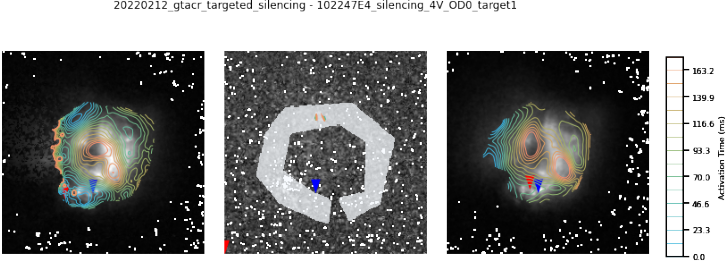

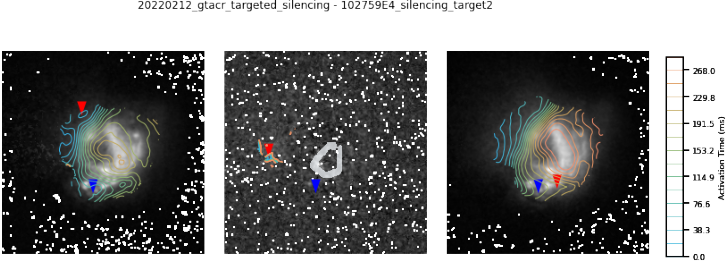

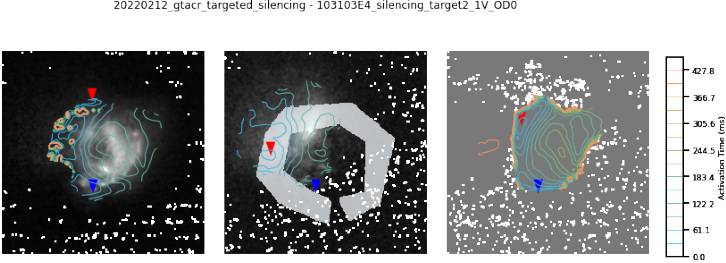

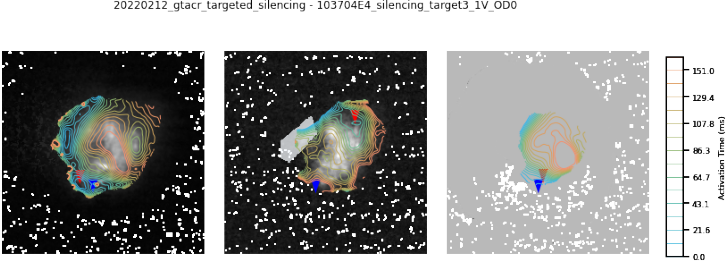

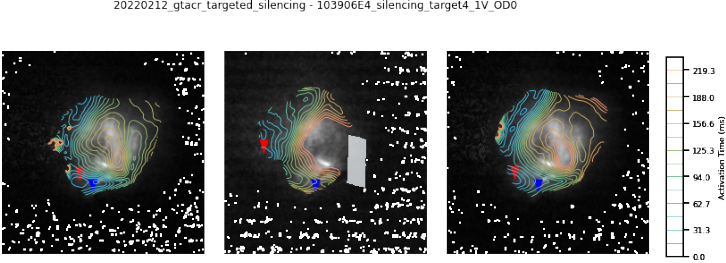

...

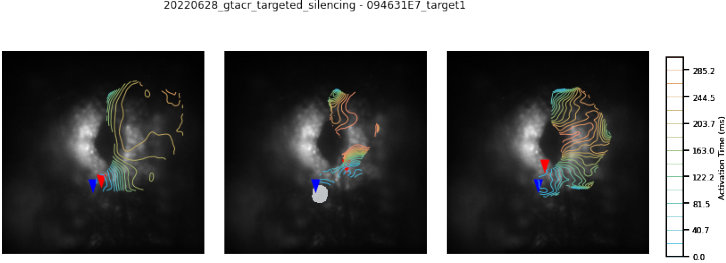

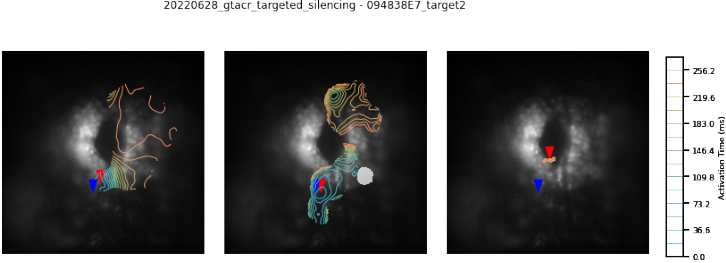

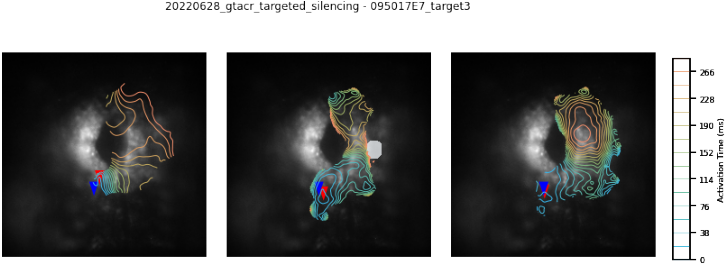

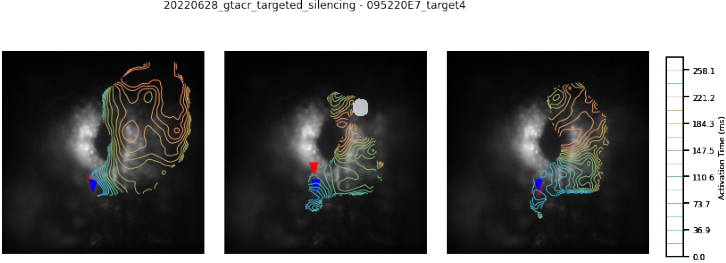

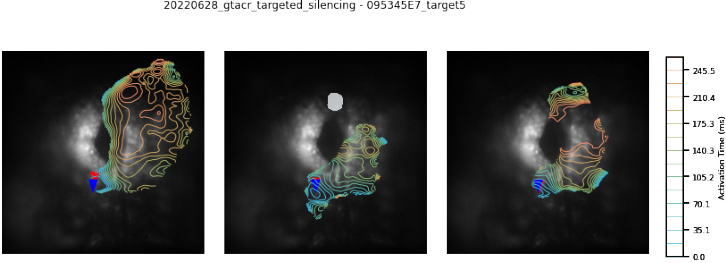

In [8]:
%matplotlib inline
plt.close("all")
subfolder = "downsampled"
for expt in experiments:
    erred_files = {}
    data = []
    rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
    expts_by_embryo, snap_info = prep_expt_metadata(rootdir)
    expts_by_embryo = expts_by_embryo[~(expts_by_embryo["target"].values == None)]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["orange_target"].values == None]
    expts_by_embryo = expts_by_embryo[expts_by_embryo["ramp"].values == None]
    for embryo in expts_by_embryo.index.unique():
        with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as pkl:
            embryo_data = pickle.load(pkl)
        for f in list(embryo_data["trace_data"].keys()):
            im = skio.imread(os.path.join(rootdir, "analysis", subfolder, f, "loi_shifts.tif"))
            fig1, ax1 = plt.subplots(figsize=(13,5))
            ax1.imshow(im)
            ax1.set_axis_off()


In [ ]:
all_loi_measurements = pd.concat([pd.read_csv(\
            os.path.join("/n/holyscratch01/cohen_lab/bjia", e, "analysis", subfolder, "loi_data.csv")) for e in experiments])
del all_loi_measurements["Unnamed: 0"]

In [ ]:
all_loi_measurements.to_csv(os.path.join(\
    "/n/holyscratch01/cohen_lab/bjia/20220507_all_gtacr_silencing_experiments/loi_measurements.csv"),\
    index=False)

### Demo silencing

In [9]:
expt = experiments[2]
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", expt)
embryo = 4
with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as pkl:
    embryo_data = pickle.load(pkl)

2091
$3\%$
$\Delta F/F$
2091


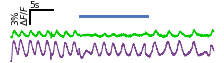

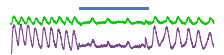

In [10]:
plt.close("all")


# embryo = 3
# f1 = "121100gtacr_E3_target3_2V"
# roi1 = 2
# f2 = "120840gtacr_E3_target2_2V"
# roi2 = 1


f1 = "114756gtacr_E4_target3_1.5V"
roi1 = 2
f2 = "113246gtacr_E4_target1_0.7V"
roi2 = 0
rep_traces = []




dFFs_1 = embryo_data["trace_data"][f1]["dFFs"]
dFFs_2 = embryo_data["trace_data"][f2]["dFFs"]
dt = np.mean(np.diff(embryo_data["trace_data"][f1]["t"]))

fig1, ax1 = plt.subplots(figsize=(4,1))
tr1 = np.concatenate([dFFs_1["before"][roi1], dFFs_1["during"][roi1],\
                    dFFs_1["after"][roi1]])
tr2 = np.concatenate([dFFs_1["before"][roi2], dFFs_1["during"][roi2],\
                    dFFs_1["after"][roi2]])

ax1.plot(dt*np.arange(len(tr1)), tr1-1+0.04, color="C2")
ax1.plot(dt*np.arange(len(tr2)), tr2-1, color="#79438e")
print(len(tr2))
ax1.set_ylim(-0.015, 0.1)
xlim = ax1.get_xlim()
ylim = ax1.get_ylim()
scalebar_params = {
    "corner_x": xlim[0]+6,
    "corner_y": ylim[1]*0.95,
    "ampl_scale": 0.03,
    "time_scale": 5,
    "fontsize": 9,
    "thickness": ylim[1]*0.02,
    "xlabel_offset_y": 0.006,
    "xlabel_offset_x": 0,
    "ylabel_offset_x": -4,
    "ylabel_offset_y": 0.003
    }
visualize.plot_scalebars(ax1, scalebar_params, pct_f=True)
visualize.plot_img_scalebar(fig1, ax1, 14.5, 0.08, 14.5, 0.005,\
              yax_direction="up", color="#5076BA", show_label=False)
plt.savefig(os.path.join(figdir, "Figure4", "silencing_non_loi_example_traces.svg"))
# tr2 = np.concatenate([dFFs_2["before"], dFFs_2["during"], dFFs_2["after"]])

fig1, ax1 = plt.subplots(figsize=(4,1))
ax1.set_ylim(-0.015, 0.1)
tr1 = np.concatenate([dFFs_2["before"][roi1], dFFs_2["during"][roi1],\
                    dFFs_2["after"][roi1]])
tr2 = np.concatenate([dFFs_2["before"][roi2], dFFs_2["during"][roi2],\
                    dFFs_2["after"][roi2]])
ax1.plot(dt*np.arange(len(tr1)), tr1-1+0.05, color="C2")
ax1.plot(dt*np.arange(len(tr2)), tr2-1, color="#79438e")
print(len(tr2))
ax1.set_axis_off()
visualize.plot_img_scalebar(fig1, ax1, 14.5, 0.08, 14.5, 0.005,\
              yax_direction="up", color="#5076BA", show_label=False)
plt.savefig(os.path.join(figdir, "Figure4", "silencing_loi_example_traces.svg"))

2091
$3\%$
$\Delta F/F$
2091


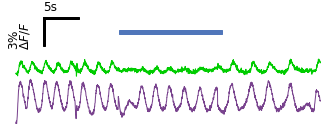

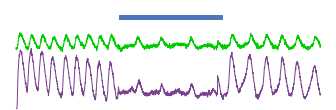

In [41]:
with plt.style.context("../bio_pubs_presentation.mplstyle"):
    plt.close("all")


    # embryo = 3
    # f1 = "121100gtacr_E3_target3_2V"
    # roi1 = 2
    # f2 = "120840gtacr_E3_target2_2V"
    # roi2 = 1


    f1 = "114756gtacr_E4_target3_1.5V"
    roi1 = 2
    f2 = "113246gtacr_E4_target1_0.7V"
    roi2 = 0
    rep_traces = []




    dFFs_1 = embryo_data["trace_data"][f1]["dFFs"]
    dFFs_2 = embryo_data["trace_data"][f2]["dFFs"]
    dt = np.mean(np.diff(embryo_data["trace_data"][f1]["t"]))

    fig1, ax1 = plt.subplots(figsize=(6,2))
    tr1 = np.concatenate([dFFs_1["before"][roi1], dFFs_1["during"][roi1],\
                        dFFs_1["after"][roi1]])
    tr2 = np.concatenate([dFFs_1["before"][roi2], dFFs_1["during"][roi2],\
                        dFFs_1["after"][roi2]])

    ax1.plot(dt*np.arange(len(tr1)), tr1-1+0.04, color="C2")
    ax1.plot(dt*np.arange(len(tr2)), tr2-1, color="#79438e")
    print(len(tr2))
    ax1.set_ylim(-0.015, 0.1)
    xlim = ax1.get_xlim()
    ylim = ax1.get_ylim()
    scalebar_params = {
        "corner_x": xlim[0]+6,
        "corner_y": ylim[1]*0.96,
        "ampl_scale": 0.03,
        "time_scale": 5,
        "fontsize": 12,
        "thickness": ylim[1]*0.02,
        "xlabel_offset_y": 0.01,
        "xlabel_offset_x": 0,
        "ylabel_offset_x": -5,
        "ylabel_offset_y": 0.002
        }
    visualize.plot_scalebars(ax1, scalebar_params, pct_f=True)
    visualize.plot_img_scalebar(fig1, ax1, 14.5, 0.08, 14.5, 0.005,\
                  yax_direction="up", color="#5076BA", show_label=False)
    plt.savefig(os.path.join(figdir, "Figure4", "POSTER_silencing_non_loi_example_traces.svg"))
    # tr2 = np.concatenate([dFFs_2["before"], dFFs_2["during"], dFFs_2["after"]])

    fig1, ax1 = plt.subplots(figsize=(6,2))
    ax1.set_ylim(-0.015, 0.1)
    tr1 = np.concatenate([dFFs_2["before"][roi1], dFFs_2["during"][roi1],\
                        dFFs_2["after"][roi1]])
    tr2 = np.concatenate([dFFs_2["before"][roi2], dFFs_2["during"][roi2],\
                        dFFs_2["after"][roi2]])
    ax1.plot(dt*np.arange(len(tr1)), tr1-1+0.05, color="C2")
    ax1.plot(dt*np.arange(len(tr2)), tr2-1, color="#79438e")
    print(len(tr2))
    ax1.set_axis_off()
    visualize.plot_img_scalebar(fig1, ax1, 14.5, 0.08, 14.5, 0.005,\
                  yax_direction="up", color="#5076BA", show_label=False)
    plt.savefig(os.path.join(figdir, "Figure4", "POSTER_silencing_loi_example_traces.svg"))

In [12]:
# colormap for edges of ROI 1
cmatrix = np.zeros((3,2,3))
cmatrix[:,1,0] = 1
cmatrix[:,0,1:3] = np.array([0,0,0])[:,None]/255
cmatrix[:,1,1:3] = np.array([0,204,0])[:,None]/255

cdict = {'red':   cmatrix[0].tolist(),
         'green': cmatrix[1].tolist(),
         'blue':  cmatrix[2].tolist()}

cmp1 = colors.LinearSegmentedColormap('testCmap1', segmentdata=cdict, N=256)

In [13]:
# colormap for edges of ROI 1
cmatrix = np.zeros((3,2,3))
cmatrix[:,1,0] = 1
cmatrix[:,0,1:3] = np.array([0,0,0])[:,None]/255
cmatrix[:,1,1:3] = np.array([121,67,142])[:,None]/255

cdict = {'red':   cmatrix[0].tolist(),
         'green': cmatrix[1].tolist(),
         'blue':  cmatrix[2].tolist()}

cmp2 = colors.LinearSegmentedColormap('testCmap2', segmentdata=cdict, N=256)

In [14]:
strel = morphology.disk(6)

In [16]:
target_mask1 = np.copy(embryo_data["unique_targets"][embryo_data["trace_data"][f1]["target"]]).astype(float)
target_mask1[target_mask1==0] = np.nan
target_mask2 = np.copy(embryo_data["unique_targets"][embryo_data["trace_data"][f2]["target"]]).astype(float)
target_mask2[target_mask2==0] = np.nan

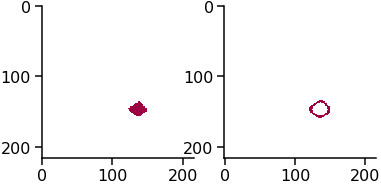

In [17]:
edges1 = feature.canny(np.nan_to_num(target_mask1), sigma=2)
edges1 = morphology.binary_closing(edges1, footprint=strel)
edges1 = morphology.binary_dilation(edges1, footprint=morphology.disk(1))
# edges2 = edges2.astype(float)
fig1, axes = plt.subplots(1,2, figsize=(6,3))
axes[0].imshow(target_mask1)
edges1 = np.ma.masked_array(edges1, mask=~edges1)
axes[1].imshow(edges1, interpolation='none')

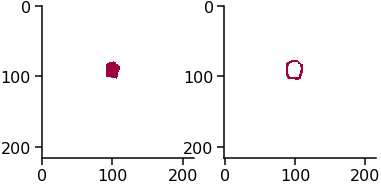

In [18]:
edges2 = feature.canny(np.nan_to_num(target_mask2), sigma=2)
edges2 = morphology.binary_closing(edges2, footprint=strel)
edges2 = morphology.binary_dilation(edges2, footprint=morphology.disk(1))
# edges2 = edges2.astype(float)
fig1, axes = plt.subplots(1,2, figsize=(6,3))
axes[0].imshow(target_mask2)
edges2 = np.ma.masked_array(edges2, mask=~edges2)
axes[1].imshow(edges2, interpolation='none')


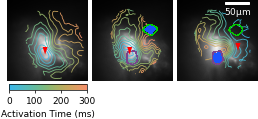

In [19]:
%matplotlib inline
vmax = 300
with plt.style.context("../bio_publications.mplstyle"):
    fig1, axes = plt.subplots(1,3, figsize=(4.5,1.5), gridspec_kw={"wspace": 0.05})
    isochrones = [embryo_data["trace_data"][f2]["before"]["smoothed_t"],
                 embryo_data["trace_data"][f1]["during"]["smoothed_t"],
                 embryo_data["trace_data"][f2]["during"]["smoothed_t"]]
    lois = [embryo_data["trace_data"][f2]["before"]["loi"],
                 embryo_data["trace_data"][f1]["during"]["loi"],
                 embryo_data["trace_data"][f2]["during"]["loi"]]

    target_mask1 = np.copy(embryo_data["unique_targets"][embryo_data["trace_data"][f1]["target"]]).astype(float)
    target_mask1[target_mask1==0] = np.nan
    target_mask2 = np.copy(embryo_data["unique_targets"][embryo_data["trace_data"][f2]["target"]]).astype(float)
    target_mask2[target_mask2==0] = np.nan

    for idx, ax in enumerate(axes):
        ax.imshow(np.flipud(embryo_data["snap"]), cmap="gray")
        q =axes[idx].contour(np.flipud(isochrones[idx]-np.nanpercentile(isochrones[idx], 2)),\
                                        levels=np.linspace(0, vmax, 10), cmap="cet_CET_I1")
        axes[idx].set_axis_off()
        loi = lois[idx]
        triangle_point = [loi[0], isochrones[idx].shape[0] - loi[1]]
        triangle_width = 10
        triangle_height = 15
        mark = patches.Polygon(np.array([triangle_point,\
                               [triangle_point[0]-triangle_width/2,triangle_point[1]-triangle_height],\
                               [triangle_point[0]+triangle_width/2,triangle_point[1]-triangle_height]]),\
                              edgecolor=None, facecolor="red", zorder=6)
        axes[idx].add_patch(mark)
        x0 = 20
        y0 = 10
        size = 160
        axes[idx].set_xlim((x0, x0+size))
        axes[idx].set_ylim((y0+size, y0))

    axes[1].imshow(np.flipud(target_mask1), alpha=1, \
                   cmap="cet_CET_L15", vmin=0, vmax=1, zorder=4)
    axes[1].imshow(np.flipud(edges1),interpolation='none', cmap=cmp1, vmin=0,vmax=1, zorder=5)

    axes[1].imshow(np.flipud(edges2),interpolation='none', cmap=cmp2, vmin=0,vmax=1, zorder=4)
    axes[2].imshow(np.flipud(target_mask2), alpha=1,\
                   cmap="cet_CET_L15", vmin=0, vmax=1, zorder=4)
    
    axes[2].imshow(np.flipud(edges1),interpolation='none', cmap=cmp1, vmin=0,vmax=1, zorder=4)

    axes[2].imshow(np.flipud(edges2),interpolation='none', cmap=cmp2, vmin=0,vmax=1, zorder=5)
    norm = mpl.colors.Normalize(vmin=0, \
                   vmax=vmax)
    cax = plt.axes([0.13, 0.05, 0.24, 0.05])
    cb1 = mpl.colorbar.ColorbarBase(cax, cmap=q.cmap, norm=norm, orientation="horizontal")
    cb1.set_label("Activation Time (ms)")
    cb1.set_ticks(np.linspace(0, vmax, 4))
    visualize.plot_img_scalebar(fig1, axes[2], 115 + x0-20, 13 + y0-10, 50, 4, pix_per_um = 1/um_per_px, fontsize=9, \
                      color="white", unit="\mu m", yax_direction="down", \
                    text_pos="above", scale=1,  show_label=True)
    plt.savefig(os.path.join(figdir, "Figure4", "silencing_isochrons.tif"), dpi=300)

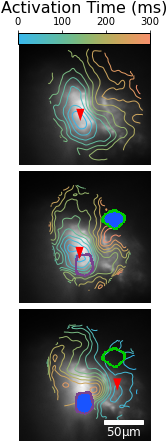

In [36]:
vmax = 300
plt.close("all")
with plt.style.context("../bio_pubs_presentation.mplstyle"):
    fig1, axes = plt.subplots(3,1, figsize=(3,7.5), gridspec_kw={"hspace": 0.05})
    isochrones = [embryo_data["trace_data"][f2]["before"]["smoothed_t"],
                 embryo_data["trace_data"][f1]["during"]["smoothed_t"],
                 embryo_data["trace_data"][f2]["during"]["smoothed_t"]]
    lois = [embryo_data["trace_data"][f2]["before"]["loi"],
                 embryo_data["trace_data"][f1]["during"]["loi"],
                 embryo_data["trace_data"][f2]["during"]["loi"]]

    target_mask1 = np.copy(embryo_data["unique_targets"][embryo_data["trace_data"][f1]["target"]]).astype(float)
    target_mask1[target_mask1==0] = np.nan
    target_mask2 = np.copy(embryo_data["unique_targets"][embryo_data["trace_data"][f2]["target"]]).astype(float)
    target_mask2[target_mask2==0] = np.nan

    for idx, ax in enumerate(axes):
        ax.imshow(np.flipud(embryo_data["snap"]), cmap="gray")
        q =axes[idx].contour(np.flipud(isochrones[idx]-np.nanpercentile(isochrones[idx], 2)),\
                                        levels=np.linspace(0, vmax, 10), cmap="cet_CET_I1")
        axes[idx].set_axis_off()
        loi = lois[idx]
        triangle_point = [loi[0], isochrones[idx].shape[0] - loi[1]]
        triangle_width = 10
        triangle_height = 15
        mark = patches.Polygon(np.array([triangle_point,\
                               [triangle_point[0]-triangle_width/2,triangle_point[1]-triangle_height],\
                               [triangle_point[0]+triangle_width/2,triangle_point[1]-triangle_height]]),\
                              edgecolor=None, facecolor="red", zorder=6)
        axes[idx].add_patch(mark)
        x0 = 20
        y0 = 10
        size = 160
        axes[idx].set_xlim((x0, x0+size))
        axes[idx].set_ylim((y0+size, y0))

    axes[1].imshow(np.flipud(target_mask1), alpha=1, \
                   cmap="cet_CET_L15", vmin=0, vmax=1, zorder=4)
    axes[1].imshow(np.flipud(edges1),interpolation='none', cmap=cmp1, vmin=0,vmax=1, zorder=5)

    axes[1].imshow(np.flipud(edges2),interpolation='none', cmap=cmp2, vmin=0,vmax=1, zorder=4)
    axes[2].imshow(np.flipud(target_mask2), alpha=1,\
                   cmap="cet_CET_L15", vmin=0, vmax=1, zorder=4)
    
    axes[2].imshow(np.flipud(edges1),interpolation='none', cmap=cmp1, vmin=0,vmax=1, zorder=4)

    axes[2].imshow(np.flipud(edges2),interpolation='none', cmap=cmp2, vmin=0,vmax=1, zorder=5)
    norm = mpl.colors.Normalize(vmin=0, \
                   vmax=vmax)
    cax = plt.axes([0.205, 0.86, 0.61, 0.020])
    cb1 = mpl.colorbar.ColorbarBase(cax, cmap=q.cmap, norm=norm, orientation="horizontal")
    cax.xaxis.set_ticks_position("top")
    cax.xaxis.set_label_position("top")
    cb1.set_label("Activation Time (ms)")
    cb1.set_ticks(np.linspace(0, vmax, 4))
    visualize.plot_img_scalebar(fig1, axes[2], 124 + x0-20, 145 + y0-10, 50, 4, pix_per_um = 1/um_per_px, fontsize=12, \
                      color="white", unit="\mu m", yax_direction="down", \
                    text_pos="above", scale=1,  show_label=True)
    plt.savefig(os.path.join(figdir, "Figure4", "POSTER_silencing_isochrons.tif"), dpi=600)

In [24]:
np.unique(edges1)

array([False,  True])

### Notes

20220212
* E4 - not useable
* E6 - not useable

20220222
* E16 not useable
* E17 not useable
* E18 works but somewhat challeng
* E8 target 2 best

20220301
* E12 did not work
* E4 good
* E3 good

20220407
* E2 did not work
* E1 sort of worked?
* E6 did not work
* E7 good
* E8 maybe good?

In [ ]:
rootdir = os.path.join("/n/holyscratch01/cohen_lab/bjia/", experiments[3])
embryo = 2
with open(os.path.join(rootdir, "analysis", "E%s.pickle" % str(embryo)), "rb") as f:
    embryo_data = pickle.load(f)

snap = embryo_data["snap"]
f = "093950E2_target1_silence_4V_larger"
os.makedirs(os.path.join(rootdir, "analysis", "downsampled", f), exist_ok=True)
img, expt_data = images.load_image(rootdir, f, subfolder="downsampled")

dFFs = embryo_data["trace_data"][f]["dFFs"]
stim_edges = embryo_data["trace_data"][f]["stim_edges"]
dt = np.mean(np.diff(embryo_data["trace_data"][f]["t"]))
pad = int(np.ceil(pad_t/dt))
sos = signal.butter(9, (0.1, 1.5), btype='band', output='sos', fs=1/dt)

delta = np.mean(np.array([img.astype(int)[stim_edges[0]+pad] - img.astype(int)[stim_edges[0]-pad],\
                          img.astype(int)[stim_edges[1]-pad] - img.astype(int)[stim_edges[1]+pad]]), axis=0)
delta = np.maximum(delta, 0)
try:
    img_mask = snap > np.percentile(snap, 80)
except Exception as e:
    mean_img = img[:stim_edges[0]-pad].mean(axis=0)
    img_mask = mean_img > np.percentile(mean_img, 80)
split_images = {"before": images.get_image_dFF(images.correct_photobleach(img[:stim_edges[0]-pad], method="monoexp",\
                                mask=img_mask)),
                "during": images.get_image_dFF(images.correct_photobleach(img[stim_edges[0]+pad:stim_edges[1]-pad]\
                            - delta, method="monoexp", mask=img_mask)),
               "after": images.get_image_dFF(images.correct_photobleach(img[stim_edges[1]+pad:], method="monoexp",\
                                mask=img_mask))}

In [ ]:
skio.imsave(os.path.join(rootdir, "analysis", "downsampled", f, "dFF_during.tif"), split_images["during"])